In [1]:
import numpy as np
import extq
import matplotlib.pyplot as plt
from matplotlib import ticker
import pyemma
import glob
import sys
import importlib
import gc
import sklearn
from sklearn import metrics
import ivac
import seaborn as sns

In [2]:
sys.path.insert(1, "../../python")
sys.path.insert(1, "../../..")
import util
import kde

In [3]:
from util import delay_embed, lift_function

In [4]:
plt.style.use("seaborn-ticks")
sns.set_palette("colorblind")

# Load data and CVs 

In [13]:
livac_trajs = np.load(
    "../../data/sb_ind100_TICA/livac_trajs_anton.npy", allow_pickle=True
)
ri_trajs = np.load("../../data/raw_feat/ri126_dist_anton.npz.npy", allow_pickle=True)
cv_trajs = np.load("../../data/raw_feat/cv_dist_spin_anton.npy", allow_pickle=True)

In [14]:
sb_labels = []
for r in ("R217", "R223", "R226", "R229", "R232"):
    for n in ("D129", "D136", "D151", "D164", "E183", "D186"):
        sb_labels.append(f"{r} - {n}")

In [15]:
remove = [
    1282,
    1283,
    1284,
    1285,
    1286,
    1288,
    1289,
    1290,
    1187,
    1188,
    1189,
    1190,
    1191,
    1197,
    1198,
    1199,
    1203,
    1205,
    1206,
    1207,
    1211,
    1212,
    1213,
    1214,
    1215,
    1225,
    1226,
    1227,
    1228,
    1231,
    1232,
    1233,
    1236,
    1237,
    1238,
    1242,
    1245,
    1246,
    1252,
    1253,
    1260,
    1261,
    1262,
    1263,
    1266,
    1267,
    1268,
    1269,
    1270,
    1271,
    1272,
    1273,
    1274,
    1275,
    1276,
    1277,
    1278,
    1279,
]

In [16]:
data_trajs = np.load("../../data/raw_feat/feat3_raw_anton.npy", allow_pickle=True)

In [17]:
print(len(livac_trajs), len(ri_trajs), len(data_trajs), len(cv_trajs))

livac_arr = np.concatenate(livac_trajs)
ri_arr = np.concatenate(ri_trajs)
data_arr = np.concatenate(data_trajs)
cv_arr = np.concatenate(cv_trajs)
print(livac_arr.shape, ri_arr.shape, data_arr.shape, cv_arr.shape)

237 237 237 237
(3000000, 5) (3000000, 5) (3000000, 130) (3000000, 2)


In [18]:
ivac_trajs = np.load("../../data/feat2_anton_ivac.npy", allow_pickle=True)
ivac_arr = np.concatenate(ivac_trajs)
print(len(ivac_trajs), ivac_trajs[0].shape)
print(ivac_arr.shape)

237 (10000, 10)
(3000000, 10)


In [19]:
sb_trajs = np.load("../../data/raw_feat/feat2_raw_anton.npy", allow_pickle=True)
sb_arr = np.concatenate(sb_trajs)
print(sb_trajs.shape)
print(sb_arr.shape)

(237,)
(3000000, 60)


# Feature 3 distance basis

## States 

In [12]:
dist = cv_arr[:, 0]
rot = cv_arr[:, 1]
tic1 = livac_arr[:, 1]
tic2 = livac_arr[:, 2]
sb1 = sb_arr[:, 42]  # R226-D129
sb2 = sb_arr[:, 47]  # R226-D186
sb3 = sb_arr[:, 48]  # R229-D129
sb4 = sb_arr[:, 53]  # R229-D186
sb5 = sb_arr[:, 59]  # R232-D186


# ellipse centered at down centroid with radii 1.1 nm and 8 deg (1 sigma in each direction)
# take points where TIC 1 < 1.2 and R2-D186 < 0.5 (lower salt bridges), R2-D129 > 0.6 (upper salt bridge)
dist_ax_down = (dist + 4.240) / 1.1
rot_ax_down = (rot + 56.95) / 8
down_ids = (
    ((dist_ax_down ** 2 + rot_ax_down ** 2) < 1)
    & (sb1 > 0.6)
    & (sb2 < 0.5)
    & (tic1 < 1.2)
).nonzero()[0]

# ellipse centered at up centroid with radii 0.84 nm and 7.6 deg (2 sigma in each direction)
# take points where TIC 2 > -1.0, R2-D129 (up) < 0.5, R3-D129 < 1.1, R3/R4-D186 salt bridges < 0.75/0.6 nm
up_ids = (
    ((((dist + 0.506) / 0.84) ** 2 + ((rot - 3.94) / 7.6) ** 2) < 1)
    & (sb1 < 0.5)
    & (sb3 < 1.1)
    & (sb4 < 0.75)
    & (sb5 < 0.6)
    & (tic2 > -1)
).nonzero()[0]

In [13]:
mask = np.ones(len(cv_arr), dtype=bool)
mask[down_ids] = False
mask[up_ids] = False

# len(**_ids) is number of points in each state
down = data_arr[down_ids]
up = data_arr[up_ids]
other = data_arr[mask]

# split CV data
down_cvs = cv_arr[down_ids]
up_cvs = cv_arr[up_ids]
other_cvs = cv_arr[mask]
down_sbs = sb_arr[down_ids]
up_sbs = sb_arr[up_ids]
other_sbs = cv_arr[mask]

In [14]:
assert (len(down) + len(up) + len(other)) == len(cv_arr)
print(f"Number of down structures:  {len(down)}")
print(f"Number of up structures:   {len(up)}")
print(f"Number of other structures: {len(other)}")

Number of down structures:  26560
Number of up structures:   4614
Number of other structures: 2968826


### Plot states 

In [25]:
import importlib

importlib.reload(util)

<module 'util' from '../../python/util.py'>

In [79]:
%matplotlib inline

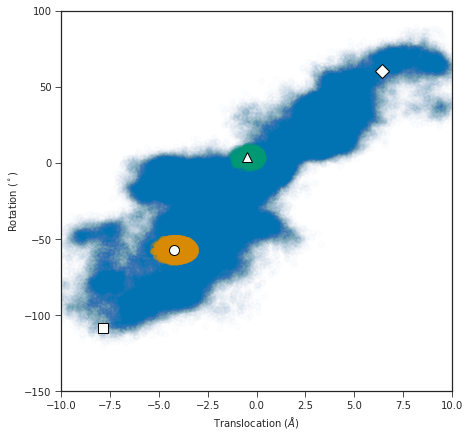

In [80]:
f = plt.figure(figsize=(7, 7))
ax = f.add_subplot(111)
s = 10
ax.scatter(cv_arr[::s, 0], cv_arr[::s, 1], alpha=0.01)
ax.scatter(down_cvs[::s, 0], down_cvs[::s, 1], alpha=0.2)
ax.scatter(up_cvs[::s, 0], up_cvs[::s, 1], alpha=0.2)
util.format_cvs(ax, centroids=True)

In [27]:
from itertools import combinations

In [28]:
feat2_models = np.load("../../data/models_centroids_feat2.npy")

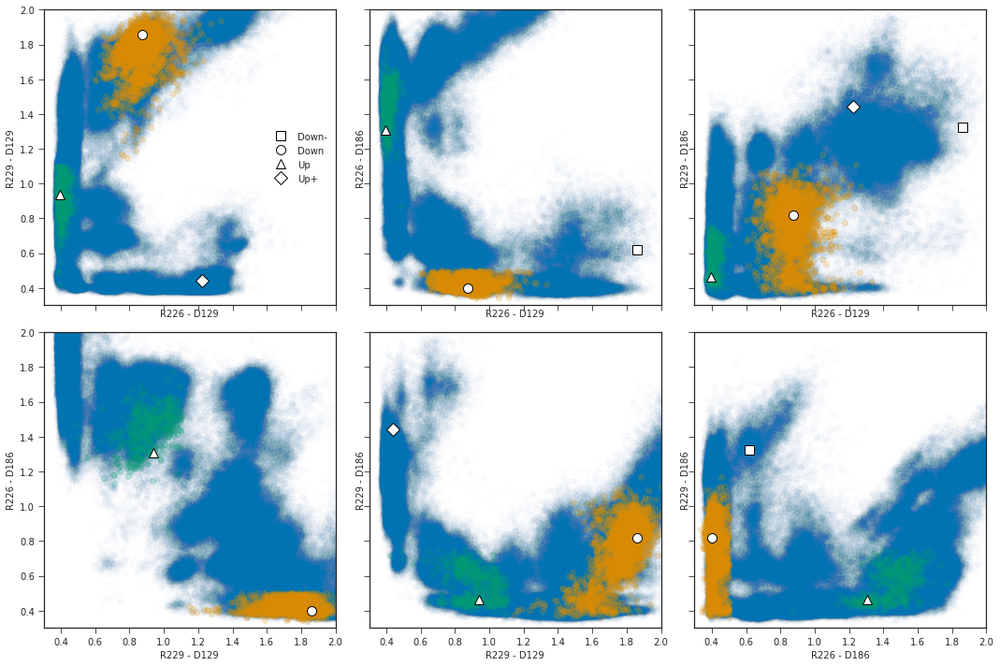

In [39]:
f, axes = plt.subplots(2, 3, figsize=(15, 10), sharex=True, sharey=True)
# 20 ns lag
sb_ids = [42, 48, 47, 53]
for ((sb1, sb2), ax) in zip(combinations(sb_ids, 2), axes.flat):
    ax.scatter(sb_arr[::s, sb1], sb_arr[::s, sb2], alpha=0.01)
    ax.scatter(down_sbs[::s, sb1], down_sbs[::s, sb2], alpha=0.2)
    ax.scatter(up_sbs[::s, sb1], up_sbs[::s, sb2], alpha=0.2)
    ax.set(xlabel=sb_labels[sb1 - 30], ylabel=sb_labels[sb2 - 30])

axes[0][0].set(xlim=[0.3, 2.0], ylim=[0.3, 2.0])
util.plot_models(axes[0][0], feat2_models[:, 42:49:6])  # indexes 42 and 48
util.plot_models(axes[0][1], feat2_models[:, 42:48:5])  # 42 and 47
util.plot_models(axes[0][2], feat2_models[:, 42:54:11])  # 42 and 53
util.plot_models(axes[1][0], feat2_models[:, 48:46:-1])  # indexes 48 and 47
util.plot_models(axes[1][1], feat2_models[:, 48:54:5])  # 48 and 53
util.plot_models(axes[1][2], feat2_models[:, 47:54:6])  # 47 and 53
axes[0][0].legend(["Down-", "Down", "Up", "Up+"])
f.tight_layout()

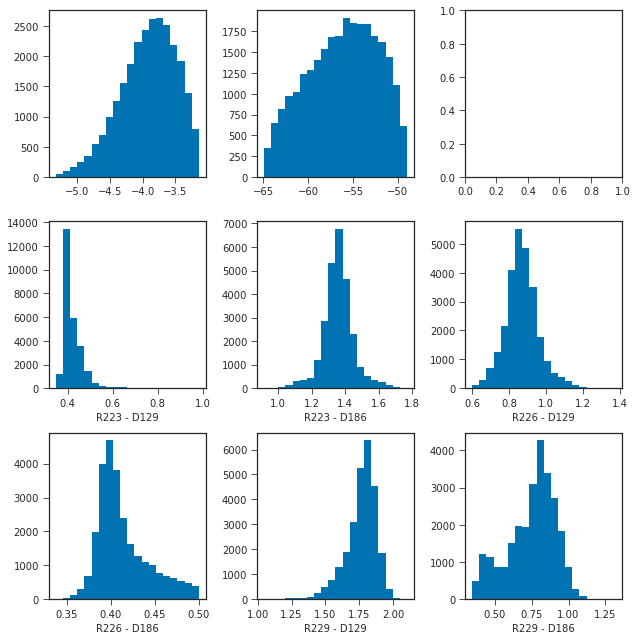

In [40]:
# histograms of CVs
f, axs = plt.subplots(3, 3, figsize=(9, 9))
axs[0][0].hist(down_cvs[:, 0], bins=20)
axs[0][1].hist(down_cvs[:, 1], bins=20)
# axs[0][2].hist(down_livac[:, 1], bins=20)
for i, (idx, ax) in enumerate(zip((36, 41, 42, 47, 48, 53), axs.flat[3:])):
    ax.hist(down_sbs[:, idx], bins=20)
    ax.set_xlabel(f"{sb_labels[idx - 30]}")
f.tight_layout()

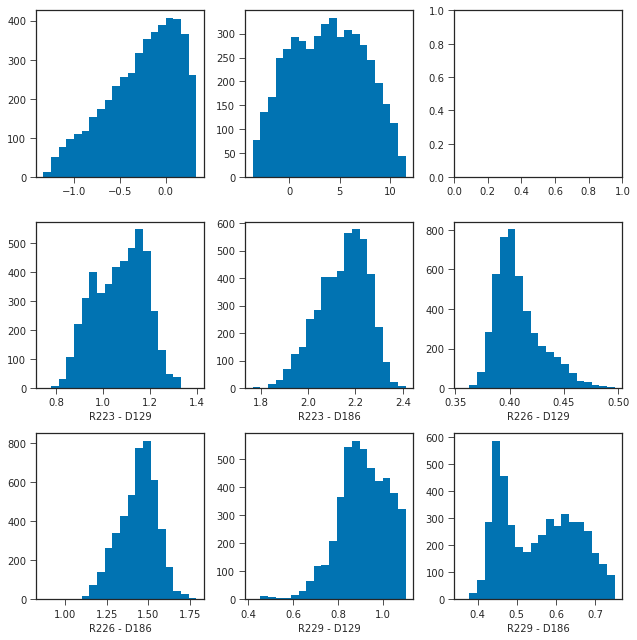

In [41]:
# histograms of CVs
f, axs = plt.subplots(3, 3, figsize=(9, 9))
axs[0][0].hist(up_cvs[:, 0], bins=20)
axs[0][1].hist(up_cvs[:, 1], bins=20)
# axs[0][2].hist(down_livac[:, 1], bins=20)
for i, (idx, ax) in enumerate(zip((36, 41, 42, 47, 48, 53), axs.flat[3:])):
    ax.hist(up_sbs[:, idx], bins=20)
    ax.set_xlabel(f"{sb_labels[idx - 30]}")
f.tight_layout()

## Pairwise distances

In [42]:
# compute minimum distance (minimum of column) from domain to dimeric/monomeric state
def reduce_func(D_chunk, start):
    min2 = np.min(D_chunk, axis=1)
    return min2

In [18]:
dist = cv_arr[:, 0]
rot = cv_arr[:, 1]
tic1 = livac_arr[:, 1]
tic2 = livac_arr[:, 2]
sb1 = sb_arr[:, 47]  # R2-D186
sb3 = sb_arr[:, 42]  # R2-D129
sb5 = sb_arr[:, 47]  # R2-D186
sb6 = sb_arr[:, 53]  # R3-D186
sb7 = sb_arr[:, 59]  # R4-D186c


# ellipse centered at (-4.24, -56.10) with radii 1.1 nm and 8 deg (1 sigma in each direction) for down state
# take points where TIC 1 < 1.2 and R2 < 0.5 (lower salt bridges)
dist_ax_down = (dist + 4.240) / 1.1
rot_ax_down = (rot + 56.95) / 8
down_ids = (
    ((dist_ax_down ** 2 + rot_ax_down ** 2) < 1)
    & (sb1 < 0.5)
    & (sb3 > 0.6)
    & (tic1 < 1.2)
).nonzero()[0]

# ellipse centered at (-0.5, 3.94) with radii 0.84 nm and 7.6 deg (2 sigma in each direction) for up state
# take points where TIC 2 > -1.0 and R3/R4-D186 salt bridges < 0.5/0.6 nm, R2-D186 > 1
up_ids = (
    ((((dist + 0.506) / 0.84) ** 2 + ((rot - 3.94) / 7.6) ** 2) < 1)
    & (sb6 < 0.5)
    & (sb7 < 0.6)
    & (sb5 > 1.0)
    & (tic2 > -1)
).nonzero()[0]

### Up state 

In [43]:
d_up = []
counter = 0.0
tot = len(data_arr)
skip = 1

for chunk in metrics.pairwise_distances_chunked(
    data_arr, up[::skip], n_jobs=-1, reduce_func=reduce_func
):
    d_up.append(chunk)
    counter += float(len(chunk))
    perc = counter / tot * 100
    print(f"{perc:.2f}% completed")

0.97% completed
1.94% completed
2.91% completed
3.88% completed
4.85% completed
5.82% completed
6.79% completed
7.76% completed
8.73% completed
9.70% completed
10.67% completed
11.64% completed
12.61% completed
13.57% completed
14.54% completed
15.51% completed
16.48% completed
17.45% completed
18.42% completed
19.39% completed
20.36% completed
21.33% completed
22.30% completed
23.27% completed
24.24% completed
25.21% completed
26.18% completed
27.15% completed
28.12% completed
29.09% completed
30.06% completed
31.03% completed
32.00% completed
32.97% completed
33.94% completed
34.91% completed
35.88% completed
36.85% completed
37.82% completed
38.79% completed
39.75% completed
40.72% completed
41.69% completed
42.66% completed
43.63% completed
44.60% completed
45.57% completed
46.54% completed
47.51% completed
48.48% completed
49.45% completed
50.42% completed
51.39% completed
52.36% completed
53.33% completed
54.30% completed
55.27% completed
56.24% completed
57.21% completed
58.18% 

In [44]:
print(len(d_up), d_up[0].shape)

# Set all distances of point in monomer state to be 0 explicitly
d_up_arr = np.reshape(np.concatenate(d_up), (-1, 1))
print(d_up_arr.shape)
print(np.max(d_up_arr[up_ids]))
d_up_arr[up_ids] = 0
print(np.max(d_up_arr[up_ids]))

print(d_up_arr.shape)

104 (29089,)
(3000000, 1)
9.536743e-07
0.0
(3000000, 1)


In [45]:
np.save("../../data/feat3_dist_anton_du/dist_up", d_up_arr)

### Down state

In [47]:
d_down = []
counter = 0.0

for chunk in metrics.pairwise_distances_chunked(
    data_arr, down[::skip], n_jobs=-1, reduce_func=reduce_func
):
    d_down.append(chunk)
    counter += float(len(chunk))
    perc = counter / tot * 100
    print(f"{perc:.2f}% completed")

0.17% completed
0.34% completed
0.51% completed
0.67% completed
0.84% completed
1.01% completed
1.18% completed
1.35% completed
1.52% completed
1.68% completed
1.85% completed
2.02% completed
2.19% completed
2.36% completed
2.53% completed
2.69% completed
2.86% completed
3.03% completed
3.20% completed
3.37% completed
3.54% completed
3.71% completed
3.87% completed
4.04% completed
4.21% completed
4.38% completed
4.55% completed
4.72% completed
4.88% completed
5.05% completed
5.22% completed
5.39% completed
5.56% completed
5.73% completed
5.90% completed
6.06% completed
6.23% completed
6.40% completed
6.57% completed
6.74% completed
6.91% completed
7.07% completed
7.24% completed
7.41% completed
7.58% completed
7.75% completed
7.92% completed
8.08% completed
8.25% completed
8.42% completed
8.59% completed
8.76% completed
8.93% completed
9.10% completed
9.26% completed
9.43% completed
9.60% completed
9.77% completed
9.94% completed
10.11% completed
10.27% completed
10.44% completed
10.61

In [48]:
print(len(d_down), d_down[0].shape)

# Set all distances of point in monomer state to be 0 explicitly
d_down_arr = np.reshape(np.concatenate(d_down), (-1, 1))

print(np.max(d_down_arr[down_ids]))
d_down_arr[down_ids] = 0
assert np.max(d_down_arr[down_ids]) == 0

print(d_down_arr.shape)

594 (5053,)
8.9208066e-07
(3000000, 1)


In [49]:
np.save("../../data/feat3_dist_anton_du/dist_down", d_down_arr)

## Basis function construction

In [50]:
# make smoothing function
smooth = (d_up_arr * d_down_arr) ** 0.5 / (d_up_arr + d_down_arr)

# make guess
guess_up = (d_down_arr / (d_up_arr + d_down_arr)) ** 2
guess_down = (d_up_arr / (d_up_arr + d_down_arr)) ** 2

# make smoothing 0 at boundaries (up and down states)
smooth[(mask == 0).flatten()] = 0
# ensure homogeneous boundary conditions for guess
guess_up[up_ids] = 1
guess_up[down_ids] = 0
guess_down[down_ids] = 1
guess_down[up_ids] = 0

In [51]:
print(smooth.shape, guess_up.shape, guess_down.shape)

(3000000, 1) (3000000, 1) (3000000, 1)


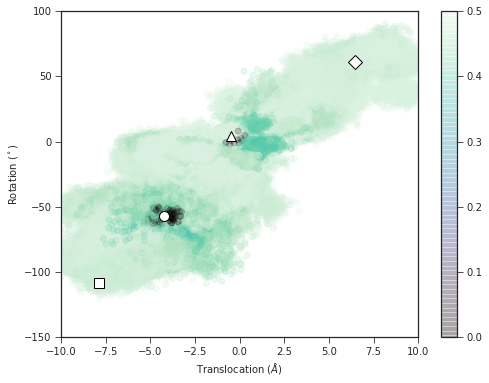

In [52]:
# Plot smoothing function
fig, ax = plt.subplots(figsize=(8, 6))
h = ax.scatter(cv_arr[::10, 0], cv_arr[::10, 1], c=smooth[::10], alpha=0.2, cmap="mako")
plt.colorbar(h, ax=ax)
util.format_cvs(ax)

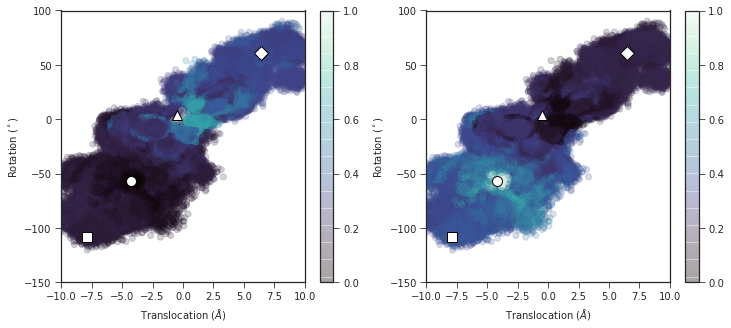

In [53]:
# Plot up and down state guess function
fig, (ax0, ax1) = plt.subplots(1, 2, figsize=(12, 5))
h0 = ax0.scatter(
    cv_arr[::10, 0], cv_arr[::10, 1], c=guess_up[::10], alpha=0.2, cmap="mako"
)
h1 = ax1.scatter(
    cv_arr[::10, 0], cv_arr[::10, 1], c=guess_down[::10], alpha=0.2, cmap="mako"
)
plt.colorbar(h0, ax=ax0)
plt.colorbar(h1, ax=ax1)
util.format_cvs(ax0)
util.format_cvs(ax1)

### SVD 

In [54]:
def svd_whiten(X, num_retain=None):
    U, L, V = np.linalg.svd(X, full_matrices=False)
    if num_retain is None:
        return U
    else:
        return U[:, :num_retain]

In [55]:
basis_smooth = smooth * data_arr
print(basis_smooth.shape)
# basis_white, L = util.svd_whiten(basis_smooth, 1, frac_retain=1.)
basis_white = svd_whiten(basis_smooth)
basis_white[(mask == 0).flatten()] = 0
print(basis_white.shape)

(3000000, 130)
(3000000, 130)


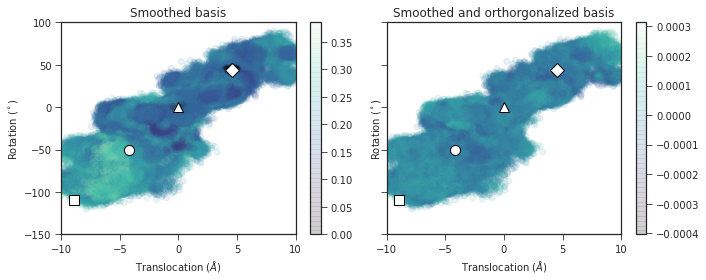

In [38]:
# plot bases
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4), sharex=True, sharey=True)
h1 = ax1.scatter(
    cv_arr[::10, 0],
    cv_arr[::10, 1],
    c=np.mean(basis_smooth[::10, :], axis=1),
    alpha=0.1,
    cmap="mako",
)
h2 = ax2.scatter(
    cv_arr[::10, 0],
    cv_arr[::10, 1],
    c=np.mean(basis_white[::10, :], axis=1),
    alpha=0.1,
    cmap="mako",
)
for ax in (ax1, ax2):
    util.format_cvs(ax)
ax1.set_title("Smoothed basis")
ax2.set_title("Smoothed and orthorgonalized basis")
plt.colorbar(h1, ax=ax1)
plt.colorbar(h2, ax=ax2)
f.tight_layout()

### Make bases

In [56]:
traj_lens = [len(traj) for traj in cv_trajs]
traj_inds = []
subtot = 0
for length in traj_lens[:-1]:
    subtot += length
    traj_inds.append(subtot)

basisF = np.split(basis_white, traj_inds)
guessD = np.split(np.squeeze(guess_down), traj_inds)
guessU = np.split(np.squeeze(guess_up), traj_inds)

print(len(basisF), basisF[0].shape)
print(len(guessD))
print(len(guessU))

237 (10000, 130)
237
237


## weights 

In [15]:
# unit is 0.1 ps, up to 500 ns
lags = [1, 2, 5, 10, 20, 50, 100, 200, 500, 1000, 2000]

In [58]:
weights = np.load("../../data/coms_feat5_ind200_anton.npy", allow_pickle=True)
print(len(weights), weights[0].shape, weights[0][0].shape)

14 (237,) (10000,)


## committors 

In [59]:
in_domain = np.split(mask, traj_inds)
in_domain[0].shape

(10000,)

In [60]:
q_downup, q_updown, qb_downup, qb_updown = [], [], [], []
for (lag, com) in zip(lags, weights):
    print(f"Calculating committors for lag {lag}")
    q_downup.append(extq.dga.forward_committor(basisF, com, in_domain, guessU, lag))
    qb_downup.append(extq.dga.backward_committor(basisF, com, in_domain, guessD, lag))
    q_updown.append(extq.dga.forward_committor(basisF, com, in_domain, guessD, lag))
    qb_updown.append(extq.dga.backward_committor(basisF, com, in_domain, guessU, lag))

Calculating committors for lag 1
Calculating committors for lag 2
Calculating committors for lag 5
Calculating committors for lag 10
Calculating committors for lag 20
Calculating committors for lag 50
Calculating committors for lag 100
Calculating committors for lag 200
Calculating committors for lag 500
Calculating committors for lag 1000
Calculating committors for lag 2000


In [61]:
np.save("../../data/feat3_dist_anton_du/q_downup", q_downup)
np.save("../../data/feat3_dist_anton_du/qb_downup", qb_downup)
np.save("../../data/feat3_dist_anton_du/q_updown", q_updown)
np.save("../../data/feat3_dist_anton_du/qb_updown", qb_updown)

/project2/roux/scguo/anaconda/envs/py37/lib/python3.7/site-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


### Forward committor

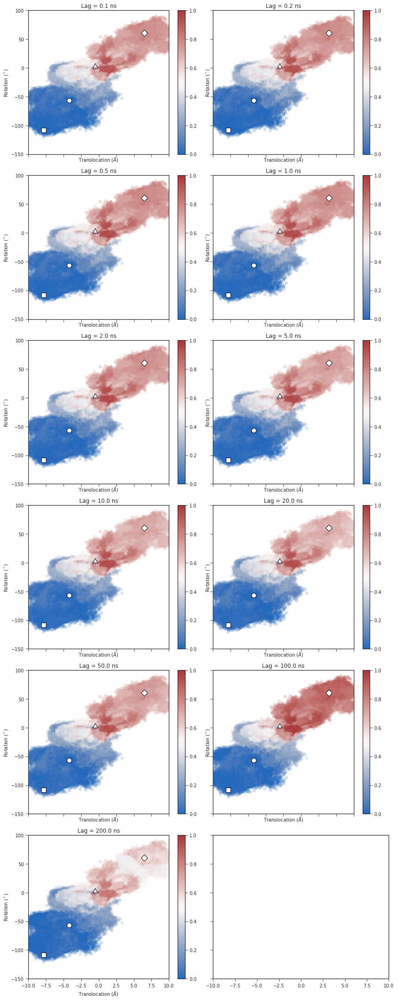

In [65]:
f, axs = plt.subplots(6, 2, figsize=(12, 30), sharex=True, sharey=True)
for lag, q, ax in zip(lags, q_downup, axs.flatten()):
    q_arr = np.concatenate(q).clip(min=0.0, max=1.0)
    h = ax.scatter(*cv_arr[::s].T, c=q_arr[::s], cmap="vlag", alpha=0.2)
    cbar = plt.colorbar(h, ax=ax)
    cbar.solids.set(alpha=1)
    ax.set_title(f"Lag = {lag * 0.1} ns")
    util.format_cvs(ax, centroids=True)
f.tight_layout()

In [102]:
# useful salt bridges for down to up transition
# R226-D129, R229-D129, R226-D186, R229-D186
sb_ids = [42, 48, 47, 53]

In [103]:
from itertools import combinations

In [104]:
feat2_models = np.load("../../data/models_centroids_feat2.npy")

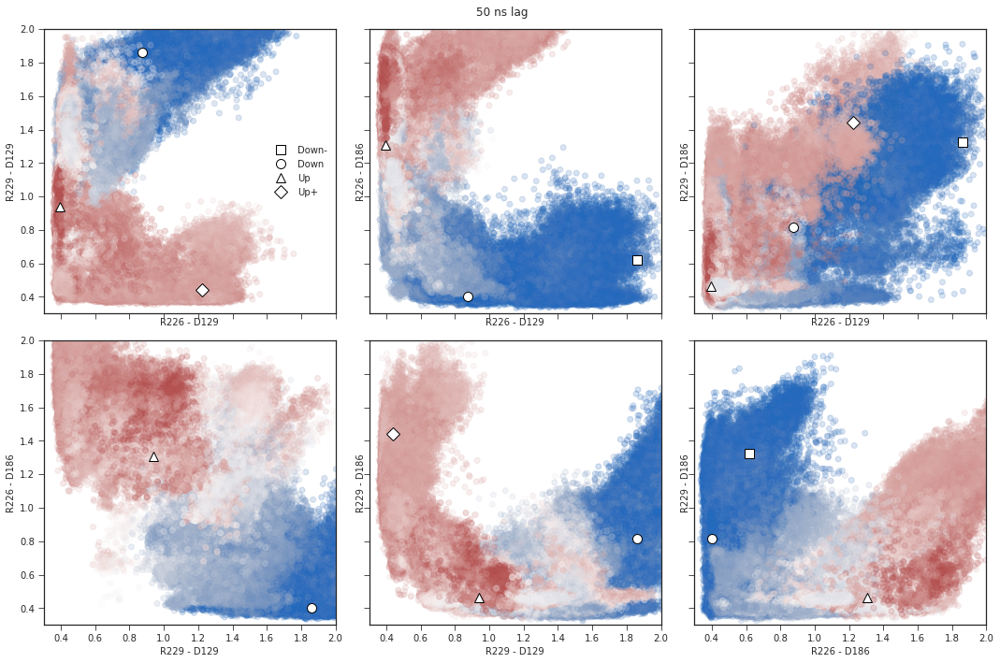

In [69]:
f, axes = plt.subplots(2, 3, figsize=(15, 10), sharex=True, sharey=True)
# 50 ns lag
q_arr = np.concatenate(q_downup[8]).clip(min=0.0, max=1.0)
for ((sb1, sb2), ax) in zip(combinations(sb_ids, 2), axes.flat):
    ax.scatter(
        sb_arr[::10, sb1], sb_arr[::10, sb2], c=q_arr[::10], cmap="vlag", alpha=0.2
    )
    ax.set(xlabel=sb_labels[sb1 - 30], ylabel=sb_labels[sb2 - 30])

axes[0][0].set(xlim=[0.3, 2.0], ylim=[0.3, 2.0])
util.plot_models(axes[0][0], feat2_models[:, 42:49:6])  # indexes 42 and 48
util.plot_models(axes[0][1], feat2_models[:, 42:48:5])  # 42 and 47
util.plot_models(axes[0][2], feat2_models[:, 42:54:11])  # 42 and 53
util.plot_models(axes[1][0], feat2_models[:, 48:46:-1])  # indexes 48 and 47
util.plot_models(axes[1][1], feat2_models[:, 48:54:5])  # 48 and 53
util.plot_models(axes[1][2], feat2_models[:, 47:54:6])  # 47 and 53
axes[0][0].legend(["Down-", "Down", "Up", "Up+"])
f.suptitle("50 ns lag")
f.tight_layout()

# Delay embedded basis 

In [18]:
n_embed = 20
lag = 10
# use smaller input feature set
# R223-D129, R226-D129, R226-D186, R229-D129, R229-D186, R232-D186
sb_ids = [36, 42, 47, 48, 53, 59]
data_orig = [traj[:, sb_ids] for traj in sb_trajs]
embed_trajs = delay_embed(data_orig, n_embed, lag)
embed_arr = np.concatenate(embed_trajs)

print(data_orig[0].shape)
print(len(embed_trajs), embed_trajs[0].shape)
print(embed_arr.shape)

(10000, 6)
237 (9800, 126)
(2952600, 126)


In [24]:
# len(**_ids) is number of points in each state
# split into lists of trajectories
down = np.zeros(len(cv_arr), dtype=np.float)
down[down_ids] = True
down = np.split(down, traj_inds)
up = np.zeros(len(cv_arr), dtype=np.float)
up[up_ids] = True
up = np.split(up, traj_inds)

NameError: name 'traj_inds' is not defined

In [72]:
# delay embed indicator functions for states
lifted_up = lift_function(up, n_embed, lag=lag)
lifted_down = lift_function(down, n_embed, lag=lag)
print(len(lifted_up), lifted_up[0].shape)
print(len(lifted_down), lifted_down[0].shape)

237 (9800,)
237 (9800,)


In [73]:
len(up_ids)

4614

In [20]:
# lift CV data
lifted_cvs = lift_function(cv_trajs, n_embed, lag=lag)
lifted_sbs = lift_function(sb_trajs, n_embed, lag=lag)
print(len(lifted_cvs), lifted_cvs[0].shape)
print(len(lifted_sbs), lifted_sbs[0].shape)

237 (9800, 2)
237 (9800, 60)


In [21]:
lifted_cvs = np.concatenate(lifted_cvs)
lifted_sbs = np.concatenate(lifted_sbs)
print(lifted_cvs.shape, lifted_sbs.shape)

(2952600, 2) (2952600, 60)


In [26]:
lifted_ivac = np.concatenate(lift_function(ivac_trajs, n_embed, lag=lag))
print(lifted_ivac.shape)

(2952600, 10)


In [25]:
lifted_traj_lens = [len(traj) for traj in embed_trajs]
lifted_traj_inds = []
subtot = 0
for length in lifted_traj_lens[:-1]:
    subtot += length
    lifted_traj_inds.append(subtot)

# new up and upplus ids
up_arr = np.concatenate(lifted_up)
up_ids_lifted = up_arr.nonzero()[0]
down_arr = np.concatenate(lifted_down)
down_ids_lifted = down_arr.nonzero()[0]

# states in data
up_data = embed_arr[up_ids_lifted]
down_data = embed_arr[down_ids_lifted]
print(len(up_data), len(down_data))

NameError: name 'lifted_up' is not defined

### Up state 

In [77]:
d_up = []
counter = 0.0
tot = len(data_arr)
skip = 1

for chunk in metrics.pairwise_distances_chunked(
    embed_arr, up_data[::skip], n_jobs=-1, reduce_func=reduce_func
):
    d_up.append(chunk)
    counter += float(len(chunk))
    perc = counter / tot * 100
    print(f"{perc:.2f}% completed")

1.11% completed
2.21% completed
3.32% completed
4.42% completed
5.53% completed
6.64% completed
7.74% completed
8.85% completed
9.95% completed
11.06% completed
12.17% completed
13.27% completed
14.38% completed
15.48% completed
16.59% completed
17.70% completed
18.80% completed
19.91% completed
21.01% completed
22.12% completed
23.23% completed
24.33% completed
25.44% completed
26.54% completed
27.65% completed
28.76% completed
29.86% completed
30.97% completed
32.07% completed
33.18% completed
34.29% completed
35.39% completed
36.50% completed
37.61% completed
38.71% completed
39.82% completed
40.92% completed
42.03% completed
43.14% completed
44.24% completed
45.35% completed
46.45% completed
47.56% completed
48.67% completed
49.77% completed
50.88% completed
51.98% completed
53.09% completed
54.20% completed
55.30% completed
56.41% completed
57.51% completed
58.62% completed
59.73% completed
60.83% completed
61.94% completed
63.04% completed
64.15% completed
65.26% completed
66.36%

In [78]:
print(len(d_up), d_up[0].shape)

# Set all distances of point in monomer state to be 0 explicitly
d_up_arr = np.reshape(np.concatenate(d_up), (-1, 1))
print(d_up_arr.shape)
print(np.max(d_up_arr[up_ids_lifted]))
d_up_arr[up_ids_lifted] = 0
print(np.max(d_up_arr[up_ids_lifted]))

print(d_up_arr.shape)

89 (33181,)
(2952600, 1)
2.9200194e-07
0.0
(2952600, 1)


In [80]:
np.save("../../data/delay_embed/sb6_1ns_20embed/dist_up_du.npy", d_up_arr)

### Down state

In [81]:
d_down = []
counter = 0.0

for chunk in metrics.pairwise_distances_chunked(
    embed_arr, down_data[::skip], n_jobs=-1, reduce_func=reduce_func
):
    d_down.append(chunk)
    counter += float(len(chunk))
    perc = counter / tot * 100
    print(f"{perc:.2f}% completed")

0.17% completed
0.35% completed
0.52% completed
0.70% completed
0.87% completed
1.05% completed
1.22% completed
1.40% completed
1.57% completed
1.74% completed
1.92% completed
2.09% completed
2.27% completed
2.44% completed
2.62% completed
2.79% completed
2.96% completed
3.14% completed
3.31% completed
3.49% completed
3.66% completed
3.84% completed
4.01% completed
4.19% completed
4.36% completed
4.53% completed
4.71% completed
4.88% completed
5.06% completed
5.23% completed
5.41% completed
5.58% completed
5.76% completed
5.93% completed
6.10% completed
6.28% completed
6.45% completed
6.63% completed
6.80% completed
6.98% completed
7.15% completed
7.32% completed
7.50% completed
7.67% completed
7.85% completed
8.02% completed
8.20% completed
8.37% completed
8.55% completed
8.72% completed
8.89% completed
9.07% completed
9.24% completed
9.42% completed
9.59% completed
9.77% completed
9.94% completed
10.12% completed
10.29% completed
10.46% completed
10.64% completed
10.81% completed
10.

In [82]:
print(len(d_down), d_down[0].shape)

# Set all distances of point in monomer state to be 0 explicitly
d_down_arr = np.reshape(np.concatenate(d_down), (-1, 1))

print(np.max(d_down_arr[down_ids]))
d_down_arr[down_ids] = 0
assert np.max(d_down_arr[down_ids]) == 0

print(d_down_arr.shape)

565 (5232,)
5.2840443
(2952600, 1)


In [83]:
np.save("../../data/delay_embed/sb6_1ns_20embed/dist_down_du.npy", d_down_arr)

## Basis function construction

In [85]:
# make smoothing function
smooth = (d_up_arr * d_down_arr) ** 0.5 / (d_up_arr + d_down_arr)

# make guess
guess_up = (d_down_arr / (d_up_arr + d_down_arr)) ** 2
guess_down = (d_up_arr / (d_up_arr + d_down_arr)) ** 2

# make smoothing 0 at boundaries (up and down states)
mask = np.ones(len(embed_arr), dtype=bool)
mask[up_ids_lifted] = False
mask[down_ids_lifted] = False
smooth[(mask == 0).flatten()] = 0

# ensure homogeneous boundary conditions for guess
guess_up[up_ids_lifted] = 1
guess_up[down_ids_lifted] = 0
guess_down[down_ids_lifted] = 1
guess_down[up_ids_lifted] = 0

In [86]:
print(smooth.shape, guess_up.shape, guess_down.shape)

(2952600, 1) (2952600, 1) (2952600, 1)


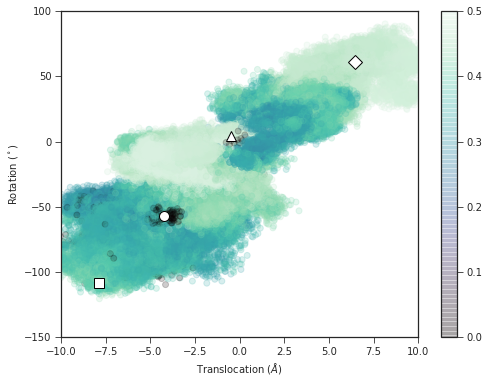

In [87]:
# Plot smoothing function
fig, ax = plt.subplots(figsize=(8, 6))
h = ax.scatter(
    lifted_cvs[::10, 0], lifted_cvs[::10, 1], c=smooth[::10], alpha=0.2, cmap="mako"
)
plt.colorbar(h, ax=ax)
util.format_cvs(ax)

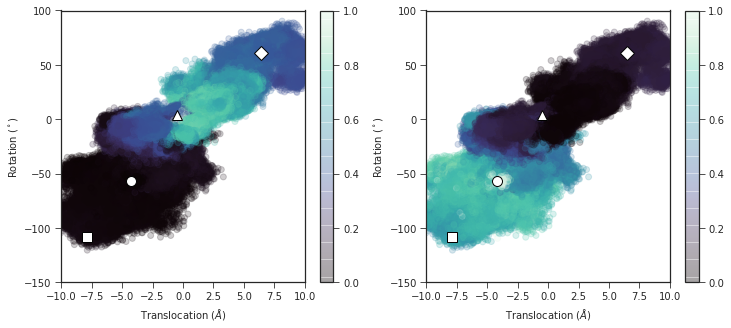

In [88]:
# Plot up and down state guess function
fig, (ax0, ax1) = plt.subplots(1, 2, figsize=(12, 5))
h0 = ax0.scatter(
    lifted_cvs[::10, 0], lifted_cvs[::10, 1], c=guess_up[::10], alpha=0.2, cmap="mako"
)
h1 = ax1.scatter(
    lifted_cvs[::10, 0], lifted_cvs[::10, 1], c=guess_down[::10], alpha=0.2, cmap="mako"
)
plt.colorbar(h0, ax=ax0)
plt.colorbar(h1, ax=ax1)
util.format_cvs(ax0)
util.format_cvs(ax1)

### SVD 

In [54]:
def svd_whiten(X, num_retain=None):
    U, L, V = np.linalg.svd(X, full_matrices=False)
    if num_retain is None:
        return U
    else:
        return U[:, :num_retain]

In [90]:
basis_smooth = smooth * embed_arr
print(basis_smooth.shape)
# basis_white, L = util.svd_whiten(basis_smooth, 1, frac_retain=1.)
basis_white = svd_whiten(basis_smooth)
basis_white[(mask == 0).flatten()] = 0
print(basis_white.shape)

(2952600, 126)
(2952600, 126)


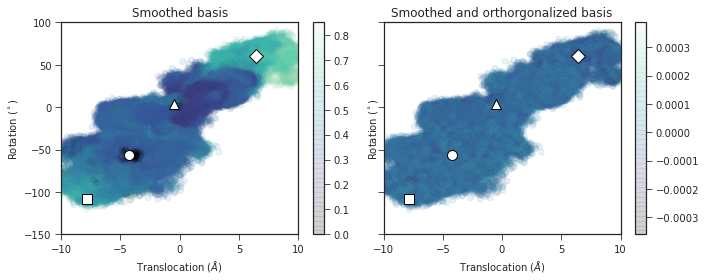

In [91]:
# plot bases
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4), sharex=True, sharey=True)
h1 = ax1.scatter(
    lifted_cvs[::10, 0],
    lifted_cvs[::10, 1],
    c=np.mean(basis_smooth[::10, :], axis=1),
    alpha=0.1,
    cmap="mako",
)
h2 = ax2.scatter(
    lifted_cvs[::10, 0],
    lifted_cvs[::10, 1],
    c=np.mean(basis_white[::10, :], axis=1),
    alpha=0.1,
    cmap="mako",
)
for ax in (ax1, ax2):
    util.format_cvs(ax)
ax1.set_title("Smoothed basis")
ax2.set_title("Smoothed and orthorgonalized basis")
plt.colorbar(h1, ax=ax1)
plt.colorbar(h2, ax=ax2)
f.tight_layout()

### Make bases

In [92]:
basisF = np.split(basis_white, lifted_traj_inds)
guessD = np.split(np.squeeze(guess_down), lifted_traj_inds)
guessU = np.split(np.squeeze(guess_up), lifted_traj_inds)

print(len(basisF), basisF[0].shape)
print(len(guessD))
print(len(guessU))

237 (9800, 126)
237
237


## weights 

In [12]:
# unit is 0.1 ps, up to 500 ns
lags = [1, 2, 5, 10, 20, 50, 100, 200, 500, 1000, 2000, 5000]

In [94]:
weights = []
for lag in lags:
    print(f"Computing change of measure for lag {lag}")
    com = extq.dga.reweight(embed_trajs, lag)
    weights.append(com)

Computing change of measure for lag 1
Computing change of measure for lag 2


KeyboardInterrupt: 

In [44]:
np.save("../../data/delay_embed/sb6_1ns_20embed/coms", weights)

/project2/roux/scguo/anaconda/envs/py37/lib/python3.7/site-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


In [13]:
weights = np.load("../../data/delay_embed/sb6_1ns_20embed/coms.npy", allow_pickle=True)

In [14]:
print(len(weights), len(weights[0]), weights[0][0].shape)

14 237 (9800,)


## committors 

In [15]:
in_domain = np.split(mask, lifted_traj_inds)
in_domain[0].shape

NameError: name 'mask' is not defined

In [98]:
q_downup, q_updown, qb_downup, qb_updown = [], [], [], []
for (lag, com) in zip(lags, weights[:11]):
    print(f"Calculating committors for lag {lag}")
    q_downup.append(extq.dga.forward_committor(basisF, com, in_domain, guessU, lag))
    qb_downup.append(extq.dga.backward_committor(basisF, com, in_domain, guessD, lag))
    q_updown.append(extq.dga.forward_committor(basisF, com, in_domain, guessD, lag))
    qb_updown.append(extq.dga.backward_committor(basisF, com, in_domain, guessU, lag))

Calculating committors for lag 1
Calculating committors for lag 2
Calculating committors for lag 5
Calculating committors for lag 10
Calculating committors for lag 20
Calculating committors for lag 50
Calculating committors for lag 100
Calculating committors for lag 200
Calculating committors for lag 500
Calculating committors for lag 1000
Calculating committors for lag 2000


In [99]:
np.save("../../data/delay_embed/sb6_1ns_10embed/q_downup_du", q_downup)
np.save("../../data/delay_embed/sb6_1ns_10embed/qb_downup_du", qb_downup)
np.save("../../data/delay_embed/sb6_1ns_10embed/q_updown_du", q_updown)
np.save("../../data/delay_embed/sb6_1ns_10embed/qb_updown_du", qb_updown)

/project2/roux/scguo/anaconda/envs/py37/lib/python3.7/site-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


In [16]:
q_downup = np.load(
    "../../data/delay_embed/sb6_1ns_10embed/q_downup_du.npy", allow_pickle=True
)
qb_downup = np.load(
    "../../data/delay_embed/sb6_1ns_10embed/qb_downup_du.npy", allow_pickle=True
)
q_updown = np.load(
    "../../data/delay_embed/sb6_1ns_10embed/q_updown_du.npy", allow_pickle=True
)
qb_updown = np.load(
    "../../data/delay_embed/sb6_1ns_10embed/qb_updown_du.npy", allow_pickle=True
)

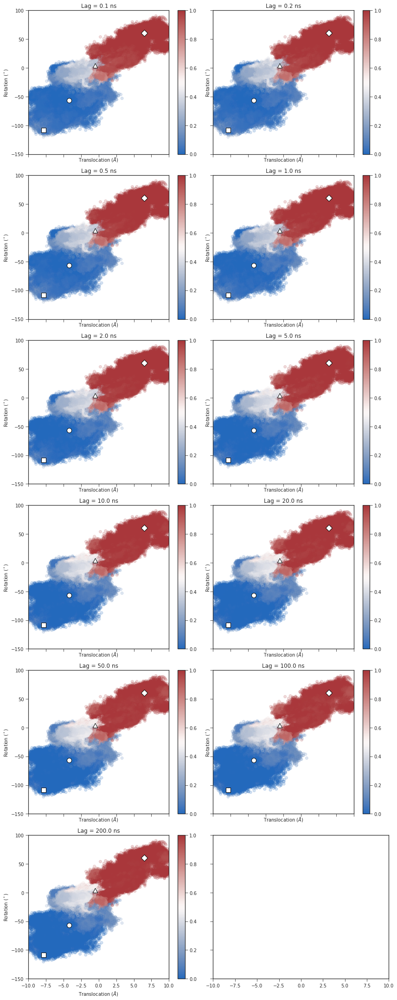

In [100]:
f, axs = plt.subplots(6, 2, figsize=(12, 30), sharex=True, sharey=True)
for lag, q, ax in zip(lags, q_downup, axs.flatten()):
    q_arr = np.concatenate(q).clip(min=0.0, max=1.0)
    h = ax.scatter(*lifted_cvs[::s].T, c=q_arr[::s], cmap="vlag", alpha=0.2)
    cbar = plt.colorbar(h, ax=ax)
    cbar.solids.set(alpha=1)
    ax.set_title(f"Lag = {lag * 0.1} ns")
    util.format_cvs(ax, centroids=True)
f.tight_layout()

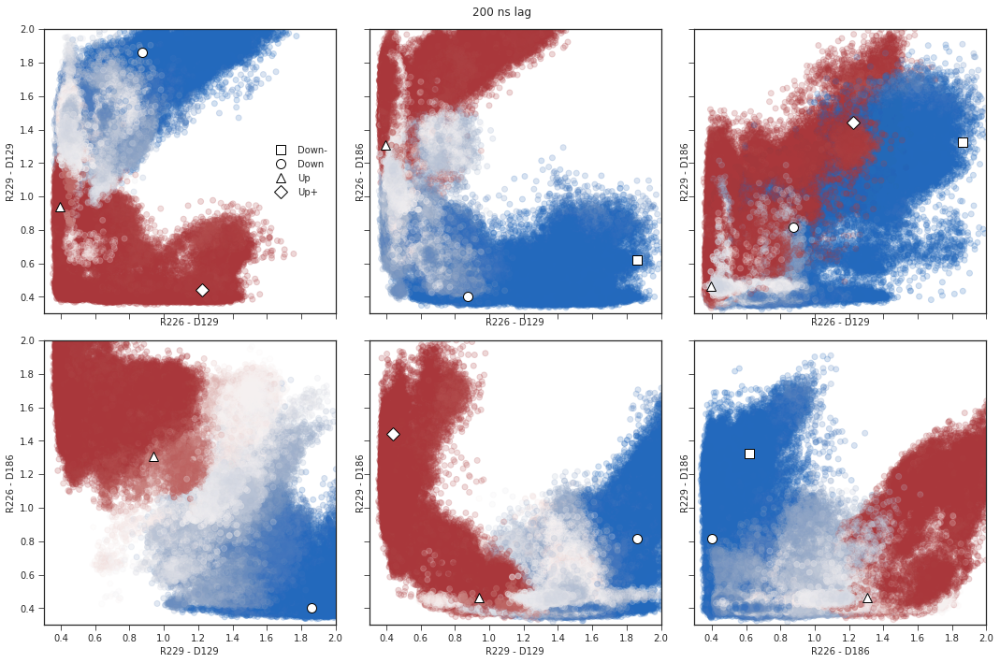

In [105]:
f, axes = plt.subplots(2, 3, figsize=(15, 10), sharex=True, sharey=True)
# 200 ns lag
q_arr = np.concatenate(q_downup[10]).clip(min=0.0, max=1.0)
for ((sb1, sb2), ax) in zip(combinations(sb_ids, 2), axes.flat):
    ax.scatter(
        lifted_sbs[::10, sb1],
        lifted_sbs[::10, sb2],
        c=q_arr[::10],
        cmap="vlag",
        alpha=0.2,
    )
    ax.set(xlabel=sb_labels[sb1 - 30], ylabel=sb_labels[sb2 - 30])

axes[0][0].set(xlim=[0.3, 2.0], ylim=[0.3, 2.0])
util.plot_models(axes[0][0], feat2_models[:, 42:49:6])  # indexes 42 and 48
util.plot_models(axes[0][1], feat2_models[:, 42:48:5])  # 42 and 47
util.plot_models(axes[0][2], feat2_models[:, 42:54:11])  # 42 and 53
util.plot_models(axes[1][0], feat2_models[:, 48:46:-1])  # indexes 48 and 47
util.plot_models(axes[1][1], feat2_models[:, 48:54:5])  # 48 and 53
util.plot_models(axes[1][2], feat2_models[:, 47:54:6])  # 47 and 53
axes[0][0].legend(["Down-", "Down", "Up", "Up+"])
f.suptitle("200 ns lag")
f.tight_layout()

In [50]:
%matplotlib inline

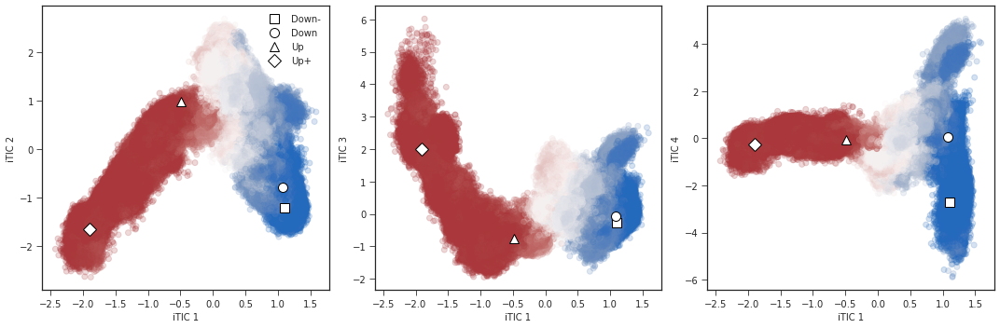

In [56]:
s = 10
f, axes = plt.subplots(1, 3, figsize=(15, 5), sharex=True)
q_arr = np.concatenate(q_downup[10]).clip(min=0.0, max=1.0)
for i, ax in enumerate(axes):
    ax.scatter(
        lifted_ivac[::s, 1],
        lifted_ivac[::s, i + 2],
        c=q_arr[::s],
        cmap="vlag",
        alpha=0.2,
    )
    ax.set(xlabel=f"iTIC 1", ylabel=f"iTIC {i + 2}")
util.plot_models(axes[0], ivac_models[:, 1:3])
util.plot_models(axes[1], ivac_models[:, 1:4:2])
util.plot_models(axes[2], ivac_models[:, 1:5:3])
axes[0].legend(["Down-", "Down", "Up", "Up+"])

f.tight_layout()

In [52]:
import pickle

In [54]:
with open("../../data/livac-feat2-anton.pkl", mode="rb") as f:
    livac = pickle.load(f)
ivac_models = livac.transform([feat2_models])[0]

###  3D projections

**7.7.21**

In [17]:
%matplotlib notebook

In [29]:
sb_ids = [42, 48, 47, 53]

<IPython.core.display.Javascript object>


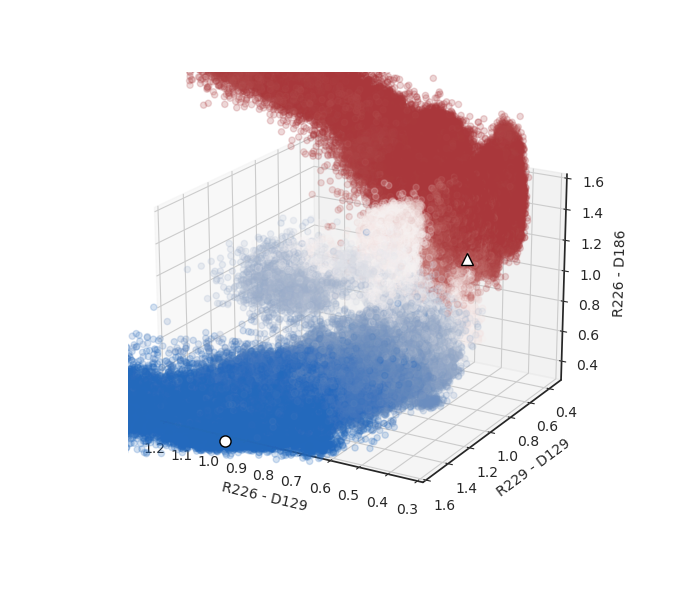

In [37]:
f = plt.figure(figsize=(7, 6))
ax = f.add_subplot(projection="3d")

q = np.concatenate(q_downup[10]).clip(min=0, max=1)
ax.scatter(
    lifted_sbs[::10, sb_ids[0]],
    lifted_sbs[::10, sb_ids[1]],
    lifted_sbs[::10, sb_ids[2]],
    c=q[::10],
    cmap="vlag",
    alpha=0.2,
)
ax.set_xlabel(sb_labels[sb_ids[0] - 30])
ax.set_ylabel(sb_labels[sb_ids[1] - 30])
ax.set_zlabel(sb_labels[sb_ids[2] - 30])
ax.set_xlim([0.3, 1.2])
ax.set_ylim([0.3, 1.6])
ax.set_zlim([0.3, 1.6])

ax.plot(
    feat2_models[1, sb_ids[0]],
    feat2_models[1, sb_ids[1]],
    feat2_models[1, sb_ids[2]],
    "o",
    mec="k",
    mfc="w",
    ms=8,
)
ax.plot(
    feat2_models[2, sb_ids[0]],
    feat2_models[2, sb_ids[1]],
    feat2_models[2, sb_ids[2]],
    "^",
    mec="k",
    mfc="w",
    ms=8,
)
ax.view_init(elev=20, azim=120)

plt.show()

In [38]:
f = plt.figure(figsize=(7, 6))
ax = f.add_subplot(projection="3d")

q = np.concatenate(q_downup[10]).clip(min=0, max=1)
ax.scatter(
    lifted_sbs[::10, sb_ids[0]],
    lifted_sbs[::10, sb_ids[1]],
    lifted_sbs[::10, sb_ids[3]],
    c=q[::10],
    cmap="vlag",
    alpha=0.2,
)
ax.set_xlabel(sb_labels[sb_ids[0] - 30])
ax.set_ylabel(sb_labels[sb_ids[1] - 30])
ax.set_zlabel(sb_labels[sb_ids[3] - 30])
ax.set_xlim([0.3, 1.2])
ax.set_ylim([0.3, 1.6])
ax.set_zlim([0.3, 1.6])

ax.plot(
    feat2_models[1, sb_ids[0]],
    feat2_models[1, sb_ids[1]],
    feat2_models[1, sb_ids[3]],
    "o",
    mec="k",
    mfc="w",
    ms=8,
)
ax.plot(
    feat2_models[2, sb_ids[0]],
    feat2_models[2, sb_ids[1]],
    feat2_models[2, sb_ids[3]],
    "^",
    mec="k",
    mfc="w",
    ms=8,
)
# ax.view_init(elev=20, azim=120)

plt.show()

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


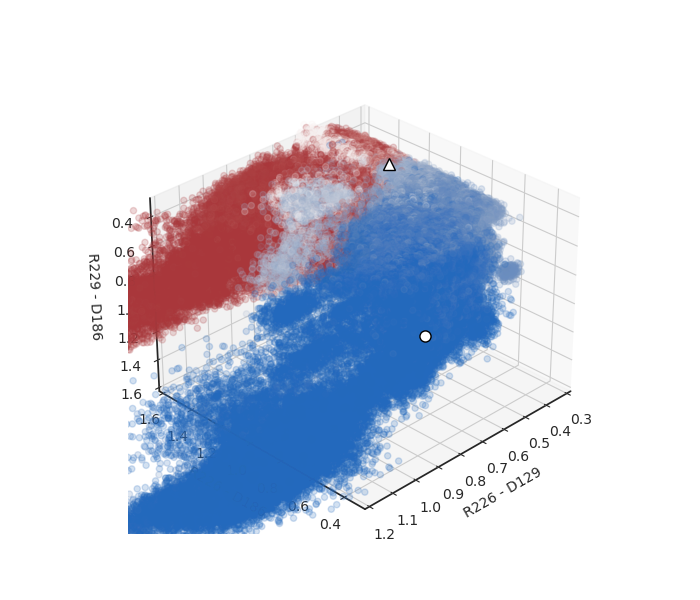

In [40]:
f = plt.figure(figsize=(7, 6))
ax = f.add_subplot(projection="3d")

q = np.concatenate(q_downup[10]).clip(min=0, max=1)
ax.scatter(
    lifted_sbs[::10, sb_ids[0]],
    lifted_sbs[::10, sb_ids[2]],
    lifted_sbs[::10, sb_ids[3]],
    c=q[::10],
    cmap="vlag",
    alpha=0.2,
)
ax.set_xlabel(sb_labels[sb_ids[0] - 30])
ax.set_ylabel(sb_labels[sb_ids[2] - 30])
ax.set_zlabel(sb_labels[sb_ids[3] - 30])
ax.set_xlim([0.3, 1.2])
ax.set_ylim([0.3, 1.6])
ax.set_zlim([0.3, 1.6])

ax.plot(
    feat2_models[1, sb_ids[0]],
    feat2_models[1, sb_ids[2]],
    feat2_models[1, sb_ids[3]],
    "o",
    mec="k",
    mfc="w",
    ms=8,
)
ax.plot(
    feat2_models[2, sb_ids[0]],
    feat2_models[2, sb_ids[2]],
    feat2_models[2, sb_ids[3]],
    "^",
    mec="k",
    mfc="w",
    ms=8,
)
ax.view_init(elev=210, azim=135)

plt.show()

<IPython.core.display.Javascript object>


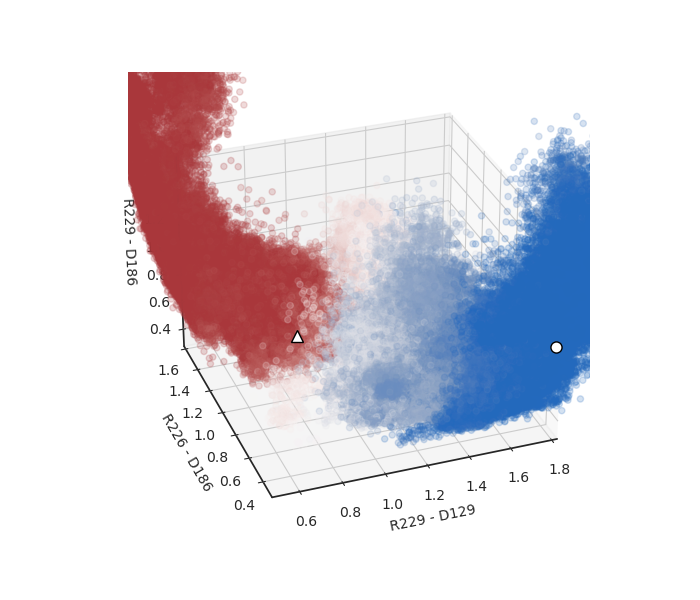

In [44]:
f = plt.figure(figsize=(7, 6))
ax = f.add_subplot(projection="3d")

q = np.concatenate(q_downup[10]).clip(min=0, max=1)
ax.scatter(
    lifted_sbs[::10, sb_ids[1]],
    lifted_sbs[::10, sb_ids[2]],
    lifted_sbs[::10, sb_ids[3]],
    c=q[::10],
    cmap="vlag",
    alpha=0.2,
)
ax.set_xlabel(sb_labels[sb_ids[1] - 30])
ax.set_ylabel(sb_labels[sb_ids[2] - 30])
ax.set_zlabel(sb_labels[sb_ids[3] - 30])
ax.set_xlim([0.5, 1.8])
ax.set_ylim([0.3, 1.6])
ax.set_zlim([0.3, 1.6])

ax.plot(
    feat2_models[1, sb_ids[1]],
    feat2_models[1, sb_ids[2]],
    feat2_models[1, sb_ids[3]],
    "o",
    mec="k",
    mfc="w",
    ms=8,
)
ax.plot(
    feat2_models[2, sb_ids[1]],
    feat2_models[2, sb_ids[2]],
    feat2_models[2, sb_ids[3]],
    "^",
    mec="k",
    mfc="w",
    ms=8,
)
ax.view_init(elev=30, azim=-110)

plt.show()

In [45]:
centroids = np.loadtxt("../../models/MD-clustering-center/all.txt")
print(centroids)

[[  -7.863 -108.573]
 [  -4.24   -56.95 ]
 [  -0.506    3.94 ]
 [   6.447   60.713]]


<IPython.core.display.Javascript object>


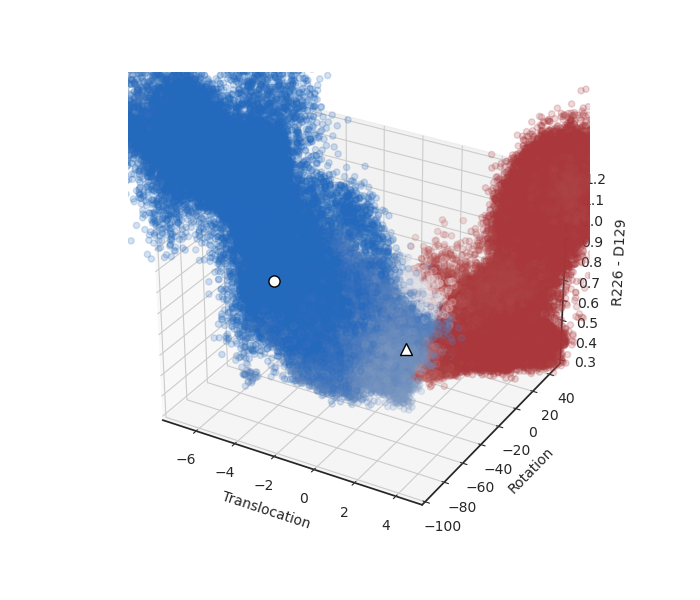

In [48]:
f = plt.figure(figsize=(7, 6))
ax = f.add_subplot(projection="3d")

s = 10
q = np.concatenate(q_downup[10]).clip(min=0, max=1)
ax.scatter(
    lifted_cvs[::s, 0],
    lifted_cvs[::s, 1],
    lifted_sbs[::s, sb_ids[0]],
    c=q[::10],
    cmap="vlag",
    alpha=0.2,
)
ax.set_xlabel("Translocation")
ax.set_ylabel("Rotation")
ax.set_zlabel(sb_labels[sb_ids[0] - 30])
ax.set_xlim([-7.5, 5])
ax.set_ylim([-100, 50])
ax.set_zlim([0.3, 1.2])

ax.plot(
    centroids[1, 0],
    centroids[1, 1],
    feat2_models[1, sb_ids[0]],
    "o",
    mec="k",
    mfc="w",
    ms=8,
)
ax.plot(
    centroids[2, 0],
    centroids[2, 1],
    feat2_models[2, sb_ids[0]],
    "^",
    mec="k",
    mfc="w",
    ms=8,
)
# ax.view_init(elev=30, azim=-110)

plt.show()

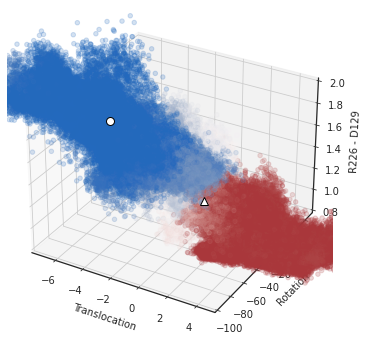

In [57]:
f = plt.figure(figsize=(7, 6))
ax = f.add_subplot(projection="3d")

s = 10
q = np.concatenate(q_downup[10]).clip(min=0, max=1)
ax.scatter(
    lifted_cvs[::s, 0],
    lifted_cvs[::s, 1],
    lifted_sbs[::s, sb_ids[1]],
    c=q[::10],
    cmap="vlag",
    alpha=0.2,
)
ax.set_xlabel("Translocation")
ax.set_ylabel("Rotation")
ax.set_zlabel(sb_labels[sb_ids[0] - 30])
ax.set_xlim([-7.5, 5])
ax.set_ylim([-100, 50])
ax.set_zlim([0.8, 2.0])

ax.plot(
    centroids[1, 0],
    centroids[1, 1],
    feat2_models[1, sb_ids[1]],
    "o",
    mec="k",
    mfc="w",
    ms=8,
)
ax.plot(
    centroids[2, 0],
    centroids[2, 1],
    feat2_models[2, sb_ids[1]],
    "^",
    mec="k",
    mfc="w",
    ms=8,
)
# ax.view_init(elev=30, azim=-110)

plt.show()

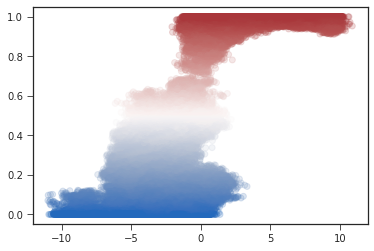

In [58]:
plt.scatter(lifted_cvs[::s, 0], q[::s], c=q[::s], cmap="vlag", alpha=0.2)

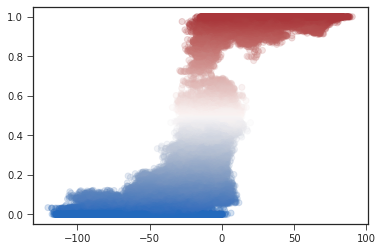

In [59]:
plt.scatter(lifted_cvs[::s, 1], q[::s], c=q[::s], cmap="vlag", alpha=0.2)

In [60]:
%matplotlib notebook

<IPython.core.display.Javascript object>


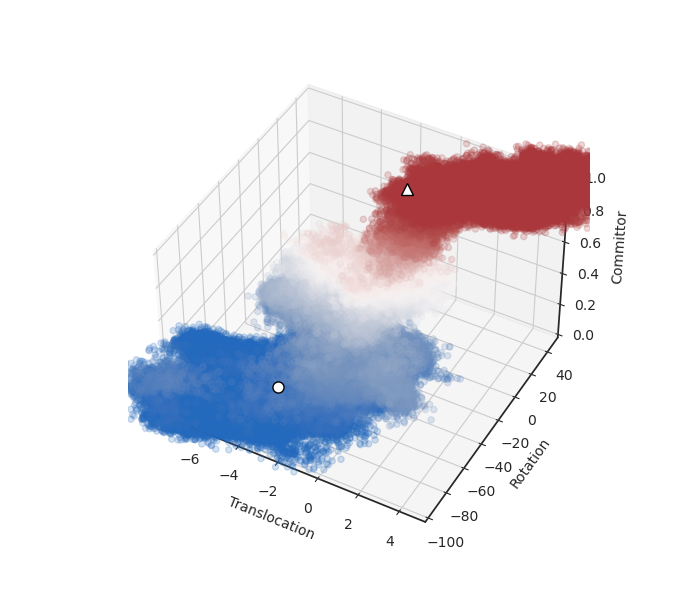

In [61]:
f = plt.figure(figsize=(7, 6))
ax = f.add_subplot(projection="3d")

s = 10
q = np.concatenate(q_downup[10]).clip(min=0, max=1)
ax.scatter(
    lifted_cvs[::s, 0], lifted_cvs[::s, 1], q[::s], c=q[::10], cmap="vlag", alpha=0.2
)
ax.set_xlabel("Translocation")
ax.set_ylabel("Rotation")
ax.set_zlabel("Committor")
ax.set_xlim([-7.5, 5])
ax.set_ylim([-100, 50])
ax.set_zlim([0, 1.0])

ax.plot(centroids[1, 0], centroids[1, 1], 0, "o", mec="k", mfc="w", ms=8)
ax.plot(centroids[2, 0], centroids[2, 1], 1, "^", mec="k", mfc="w", ms=8)

<IPython.core.display.Javascript object>


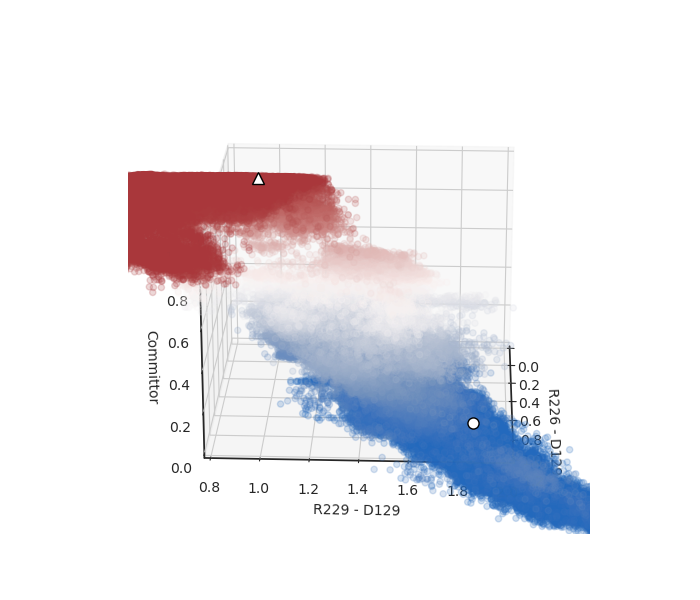

In [62]:
f = plt.figure(figsize=(7, 6))
ax = f.add_subplot(projection="3d")

s = 10
q = np.concatenate(q_downup[10]).clip(min=0, max=1)
ax.scatter(
    lifted_sbs[::s, sb_ids[0]],
    lifted_sbs[::s, sb_ids[1]],
    q[::s],
    c=q[::10],
    cmap="vlag",
    alpha=0.2,
)
ax.set_xlabel(sb_labels[sb_ids[0] - 30])
ax.set_ylabel(sb_labels[sb_ids[1] - 30])
ax.set_zlabel("Committor")
ax.set_xlim([0, 1.2])
ax.set_ylim([0.8, 2.0])
ax.set_zlim([0, 1.0])

ax.plot(
    feat2_models[1, sb_ids[0]],
    feat2_models[1, sb_ids[1]],
    0,
    "o",
    mec="k",
    mfc="w",
    ms=8,
)
ax.plot(
    feat2_models[2, sb_ids[0]],
    feat2_models[2, sb_ids[1]],
    1,
    "^",
    mec="k",
    mfc="w",
    ms=8,
)

plt.show()

<IPython.core.display.Javascript object>


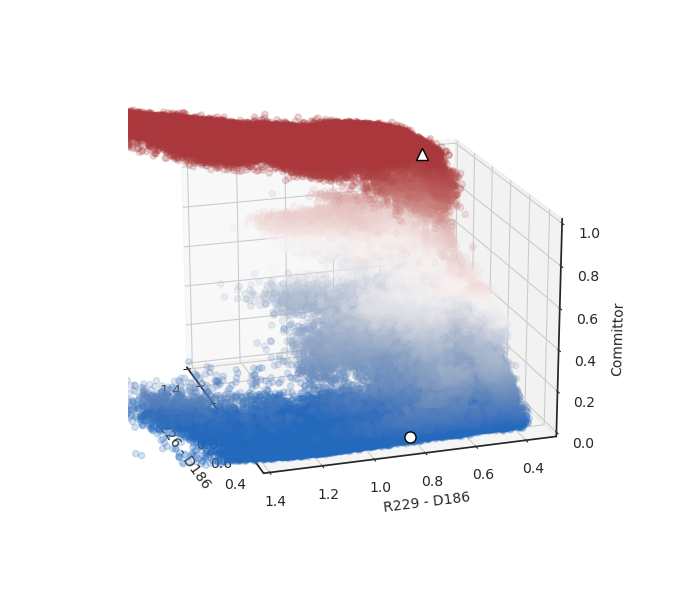

In [74]:
f = plt.figure(figsize=(7, 6))
ax = f.add_subplot(projection="3d")

s = 10
q = np.concatenate(q_downup[10]).clip(min=0, max=1)
ax.scatter(
    lifted_sbs[::s, sb_ids[2]],
    lifted_sbs[::s, sb_ids[3]],
    q[::s],
    c=q[::10],
    cmap="vlag",
    alpha=0.2,
)
ax.set_xlabel(sb_labels[sb_ids[2] - 30])
ax.set_ylabel(sb_labels[sb_ids[3] - 30])
ax.set_zlabel("Committor")
ax.set_xlim([0.3, 1.4])
ax.set_ylim([0.3, 1.4])
ax.set_zlim([0, 1.0])

ax.plot(
    feat2_models[1, sb_ids[2]],
    feat2_models[1, sb_ids[3]],
    0,
    "o",
    mec="k",
    mfc="w",
    ms=8,
)
ax.plot(
    feat2_models[2, sb_ids[2]],
    feat2_models[2, sb_ids[3]],
    1,
    "^",
    mec="k",
    mfc="w",
    ms=8,
)

plt.show()

### transition state region

In [66]:
q = np.concatenate(q_downup[10]).clip(min=0, max=1)
ids = np.argsort((q - 0.5) ** 2)
for i in ids[:20]:
    print(f"{i}: {lifted_cvs[i]}, {lifted_sbs[i, sb_ids]}")

2883344: [0.17  2.529], [0.39173847 1.4911983  1.7429502  0.57927877]
2872959: [-2.476  3.746], [0.4162464 1.4660034 1.5903326 0.6469705]
1969016: [-2.235  4.559], [0.42735955 1.4133313  1.5969055  0.6799014 ]
2580356: [-1.634 -4.239], [0.4538072 1.372865  1.1737441 0.4527715]
2510059: [-0.744  2.673], [0.47358418 1.5376875  1.6550244  0.6315854 ]
2815886: [-2.538  8.507], [0.4241533  1.5641513  1.3898597  0.46352023]
2632190: [ 0.738 -0.049], [0.4857428  1.5232229  1.7457277  0.43634275]
2828685: [0.617 8.848], [0.4513015  1.3724858  1.5842658  0.43440765]
2502230: [-1.016 -1.262], [0.46622953 1.4673929  1.4724681  0.45435667]
2699307: [ -2.321 -12.295], [0.4769339  1.2869203  0.9842693  0.46600854]
2787064: [-0.189  8.014], [0.4139771  1.5100881  1.7223046  0.52302396]
2790246: [-0.72   0.787], [0.4024364 1.4903167 1.5567033 0.4359611]
2639828: [-0.815 -8.749], [0.4622608 1.5427554 1.4527183 0.4923038]
1188167: [ -2.382 -16.761], [0.50405645 1.3554487  0.962141   0.45609114]
2787647:

1188167: (121, 2467): 

In [70]:
util.anton_frame(2929144)

(265, 9144)

In [71]:
util.anton_frame(2918559)

(264, 8559)

In [69]:
util.anton_frame(1969116)

(180, 79116)

In [72]:
lifted_cvs_trajs = lift_function(cv_trajs, n_embed, lag=lag)
lifted_sbs_trajs = lift_function(sb_trajs, n_embed, lag=lag)

In [73]:
q = q_downup[10].clip(min=0, max=1)
ids = np.argsort((q - 0.5) ** 2)
for i in ids[:20]:
    print(f"{i}: {lifted_cvs[i]}, {lifted_sbs[i, sb_ids]}")

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

# Indicator basis

**7.12.21**

In [24]:
# load discretized trajectories
dtrajs = np.load("../../data/raw_feat/feat5_ivac_ind500_anton.npy")
print(dtrajs.shape)

(3000000,)


In [61]:
dtrajs[:10]

array([148, 354, 439, 439, 310, 310, 439, 439, 439, 439], dtype=int32)

In [18]:
from scipy import sparse

In [62]:
# assemble basis using sparse matrices
nclusters = 500

rows, cols = [], []
for i in range(nclusters):
    pts = np.argwhere(dtrajs == i)
    # indices of which frames are in the cluster i
    rows.append(pts.squeeze())
    # all assigned as 1 in the basis
    cols.append(np.repeat(i, len(pts)))
rows = np.hstack(rows)
cols = np.hstack(cols)
data = np.ones(len(rows), dtype=float)
basis = sparse.csr_matrix((data, (rows, cols)), shape=(len(cv_arr), nclusters))

In [63]:
basis.shape

(3000000, 500)

In [71]:
basis[:10, 439]

<10x1 sparse matrix of type '<class 'numpy.float64'>'
	with 0 stored elements in Compressed Sparse Row format>

In [66]:
basis.count_nonzero()

3000000

In [67]:
# remove basis functions which are completely 0 (i.e. entirely contained in A U B)
nonzero = np.where(basis.sum(axis=0) > 0)[0]

basis = basis[:, nonzero]
print(basis.shape)

(3000000, 500)


In [68]:
basis[:, 2].count_nonzero()

14666

In [20]:
traj_lens = [len(traj) for traj in cv_trajs]
traj_inds = []
subtot = 0
for length in traj_lens[:-1]:
    subtot += length
    traj_inds.append(subtot)

In [23]:
# enforce boundary conditions for committor calculations
basisF_arr = basis
basisF_arr[up_ids] = 0
basisF_arr[down_ids] = 0

# split into lists of arrays
basisF, basisL = [], []
curr = 0
for t_len in traj_lens:
    basisF.append(basisF_arr[curr : curr + t_len])
    basisL.append(basis[curr : curr + t_len])
    curr += t_len

print(len(basisF), basisF[0].shape)
print(len(basisL), basisL[0].shape)

# guess functions
guess_down = np.zeros(len(cv_arr))
guess_down[down_ids] = 1
guessD = np.split(guess_down, traj_inds)
guess_up = np.zeros(len(cv_arr))
guess_up[up_ids] = 1
guessU = np.split(guess_up, traj_inds)
print(len(guessD), guessD[0].shape)
print(len(guessU), guessU[0].shape)

237 (10000, 500)
237 (10000, 500)
237 (10000,)
237 (10000,)


## Committors

In [12]:
lags = [1, 2, 5, 10, 20, 50, 100, 200, 500, 1000, 2000, 5000]

In [13]:
weights = np.load("../../data/coms_feat5_ind200_anton.npy", allow_pickle=True)

In [14]:
weights = [*weights[:11], weights[-1]]

In [15]:
print(len(weights), len(weights[0]), weights[0][0].shape)

12 237 (10000,)


In [16]:
in_domain = np.split(mask, traj_inds)

NameError: name 'mask' is not defined

In [31]:
q_downup, q_updown, qb_downup, qb_updown = [], [], [], []
for (lag, com) in zip(lags, weights):
    print(f"Calculating committors for lag {lag}")
    q_downup.append(
        extq.dga.forward_committor_sparse(basisF, com, in_domain, guessU, lag)
    )
    qb_downup.append(
        extq.dga.backward_committor_sparse(basisF, com, in_domain, guessD, lag)
    )
    q_updown.append(
        extq.dga.forward_committor_sparse(basisF, com, in_domain, guessD, lag)
    )
    qb_updown.append(
        extq.dga.backward_committor_sparse(basisF, com, in_domain, guessU, lag)
    )

Calculating committors for lag 1
Calculating committors for lag 2
Calculating committors for lag 5
Calculating committors for lag 10
Calculating committors for lag 20
Calculating committors for lag 50
Calculating committors for lag 100
Calculating committors for lag 200
Calculating committors for lag 500
Calculating committors for lag 1000
Calculating committors for lag 2000
Calculating committors for lag 5000


In [73]:
np.save("../../data/feat5_tica_ind500_du/q_downup", q_downup)
np.save("../../data/feat5_tica_ind500_du/qb_downup", qb_downup)
np.save("../../data/feat5_tica_ind500_du/q_updown", q_updown)
np.save("../../data/feat5_tica_ind500_du/qb_updown", qb_updown)

/project2/roux/scguo/anaconda/envs/py37/lib/python3.7/site-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


In [18]:
q_downup = np.load("../../data/feat5_tica_ind500_du/q_downup.npy", allow_pickle=True)
qb_downup = np.load("../../data/feat5_tica_ind500_du/qb_downup.npy", allow_pickle=True)
q_updown = np.load("../../data/feat5_tica_ind500_du/q_updown.npy", allow_pickle=True)
qb_updown = np.load("../../data/feat5_tica_ind500_du/qb_updown.npy", allow_pickle=True)

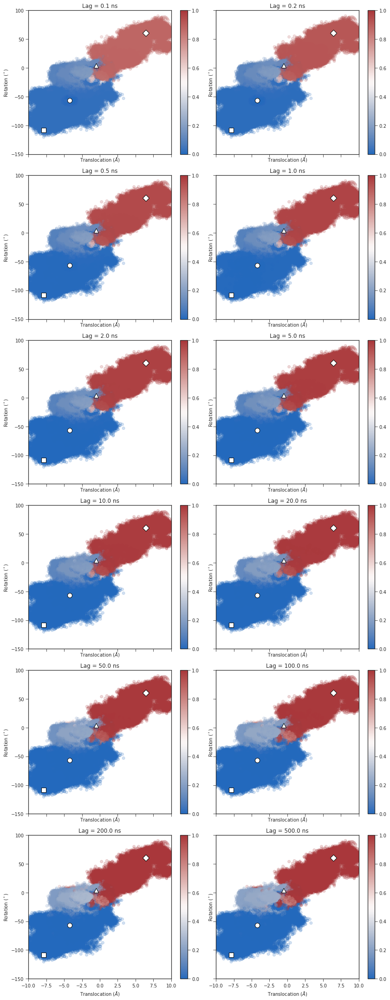

In [72]:
s = 10
f, axs = plt.subplots(6, 2, figsize=(12, 30), sharex=True, sharey=True)
for lag, q, ax in zip(lags, q_downup, axs.flatten()):
    q_arr = np.concatenate(q)
    h = ax.scatter(*cv_arr[::s].T, c=q_arr[::s], cmap="vlag", alpha=0.2)
    cbar = plt.colorbar(h, ax=ax)
    cbar.solids.set(alpha=1)
    ax.set_title(f"Lag = {lag * 0.1} ns")
    util.format_cvs(ax, centroids=True)
f.tight_layout()

In [19]:
# useful salt bridges for down to up transition
# R226-D129, R229-D129, R226-D186, R229-D186
sb_ids = [42, 48, 47, 53]

In [20]:
from itertools import combinations

In [21]:
feat2_models = np.load("../../data/models_centroids_feat2.npy")

In [23]:
import plotting

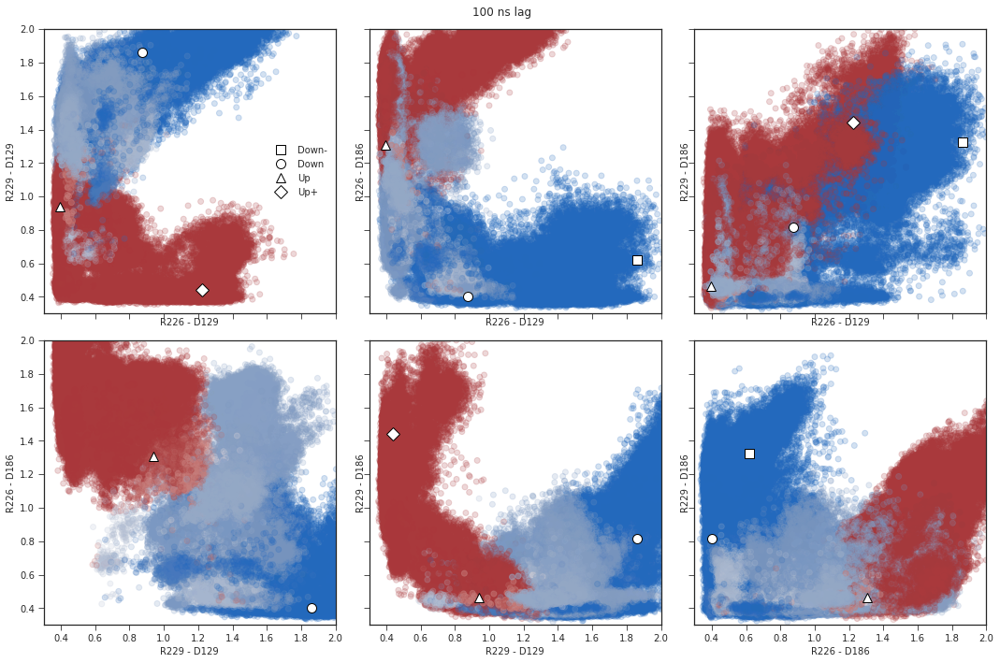

In [24]:
f, axes = plt.subplots(2, 3, figsize=(15, 10), sharex=True, sharey=True)
# 50 ns lag
q_arr = np.concatenate(q_downup[9]).clip(min=0.0, max=1.0)
for ((sb1, sb2), ax) in zip(combinations(sb_ids, 2), axes.flat):
    ax.scatter(
        sb_arr[::10, sb1], sb_arr[::10, sb2], c=q_arr[::10], cmap="vlag", alpha=0.2
    )
    ax.set(xlabel=sb_labels[sb1 - 30], ylabel=sb_labels[sb2 - 30])

axes[0][0].set(xlim=[0.3, 2.0], ylim=[0.3, 2.0])
plotting.plot_sb_models(axes.flat, mode="du", centroids=True)
axes[0][0].legend(["Down-", "Down", "Up", "Up+"])
f.suptitle("100 ns lag")
f.tight_layout()

In [34]:
feat2_models[:, 42:49:6]

array([[1.8614998 , 2.356666  ],
       [0.8725281 , 1.859189  ],
       [0.39292917, 0.9380054 ],
       [1.2229565 , 0.44004163]], dtype=float32)

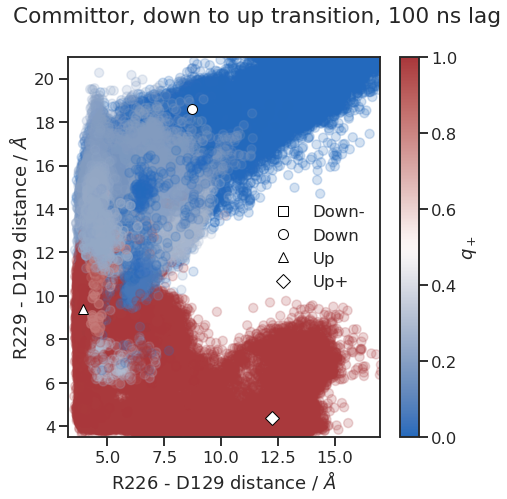

In [56]:
sns.set_context("talk")
f, ax = plt.subplots(figsize=(7, 7))
# 50 ns lag
q_arr = np.concatenate(q_downup[9]).clip(min=0.0, max=1.0)
sb1, sb2 = sb_ids[:2]
h = ax.scatter(
    sb_arr[::10, sb1] * 10,  # convert to Angstroms
    sb_arr[::10, sb2] * 10,
    c=q_arr[::10],
    cmap="vlag",
    alpha=0.2,
)
ax.set(
    xlabel=f"{sb_labels[sb1 - 30]} distance / $\AA$",
    ylabel=f"{sb_labels[sb2 - 30]} distance / $\AA$",
)
ax.set(xlim=[3.25, 17], ylim=[3.5, 21])
plotting.plot_models(ax, feat2_models[:, sb1 : (sb2 + 1) : (sb2 - sb1)] * 10)
cbar = plt.colorbar(h, ax=ax, label="$q_+$")
cbar.solids.set(alpha=1)
ax.legend(["Down-", "Down", "Up", "Up+"], loc="right")
f.suptitle("Committor, down to up transition, 100 ns lag")
plt.savefig("../../fig/committors/qf_du_r2d129_r3d129_lag1000_v2.png", dpi=400)

In [106]:
import pickle

In [107]:
with open("../../data/livac-feat2-anton.pkl", mode="rb") as f:
    livac = pickle.load(f)
ivac_models = livac.transform([feat2_models])[0]

In [ ]:
%matplotlib inline

In [ ]:
f, axes = plt.subplots(1, 3, figsize=(15, 5), sharex=True)
q_arr = np.concatenate(q_downup[10]).clip(min=0.0, max=1.0)
for i, ax in enumerate(axes):
    ax.scatter(
        ivac_arr[::s, 1], ivac_arr[::s, i + 2], c=q_arr[::s], cmap="vlag", alpha=0.2
    )
    ax.set(xlabel=f"iTIC 1", ylabel=f"iTIC {i + 2}")
util.plot_models(axes[0], ivac_models[:, 1:3])
util.plot_models(axes[1], ivac_models[:, 1:4:2])
util.plot_models(axes[2], ivac_models[:, 1:5:3])
axes[0].legend(["Down-", "Down", "Up", "Up+"])

f.tight_layout()

### 3d projections 

In [78]:
%matplotlib notebook

<IPython.core.display.Javascript object>


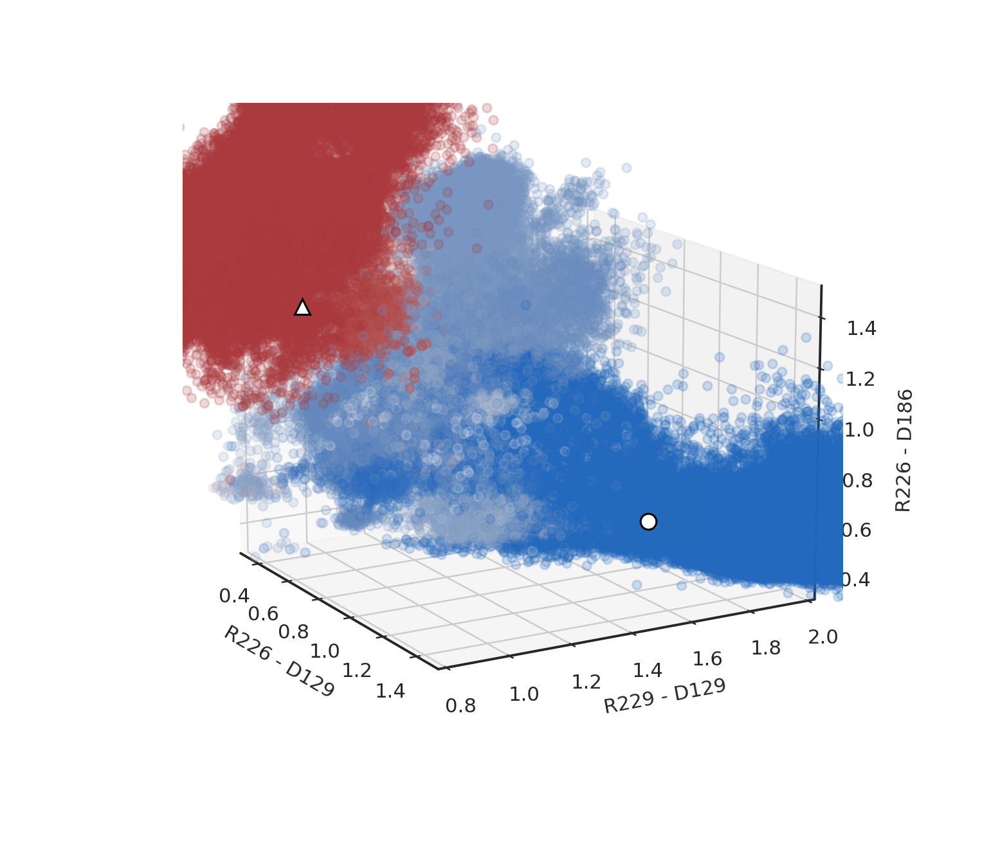

In [81]:
f = plt.figure(figsize=(7, 6))
ax = f.add_subplot(projection="3d")

q = np.concatenate(q_downup[7]).clip(min=0, max=1)
ax.scatter(
    sb_arr[::10, sb_ids[0]],
    sb_arr[::10, sb_ids[1]],
    sb_arr[::10, sb_ids[2]],
    c=q[::10],
    cmap="vlag",
    alpha=0.2,
)
ax.set_xlabel(sb_labels[sb_ids[0] - 30])
ax.set_ylabel(sb_labels[sb_ids[1] - 30])
ax.set_zlabel(sb_labels[sb_ids[2] - 30])
ax.set_xlim([0.3, 1.5])
ax.set_ylim([0.8, 2.0])
ax.set_zlim([0.3, 1.5])

ax.plot(
    feat2_models[1, sb_ids[0]],
    feat2_models[1, sb_ids[1]],
    feat2_models[1, sb_ids[2]],
    "o",
    mec="k",
    mfc="w",
    ms=8,
)
ax.plot(
    feat2_models[2, sb_ids[0]],
    feat2_models[2, sb_ids[1]],
    feat2_models[2, sb_ids[2]],
    "^",
    mec="k",
    mfc="w",
    ms=8,
)
ax.view_init(elev=15, azim=-30)

plt.show()

<IPython.core.display.Javascript object>


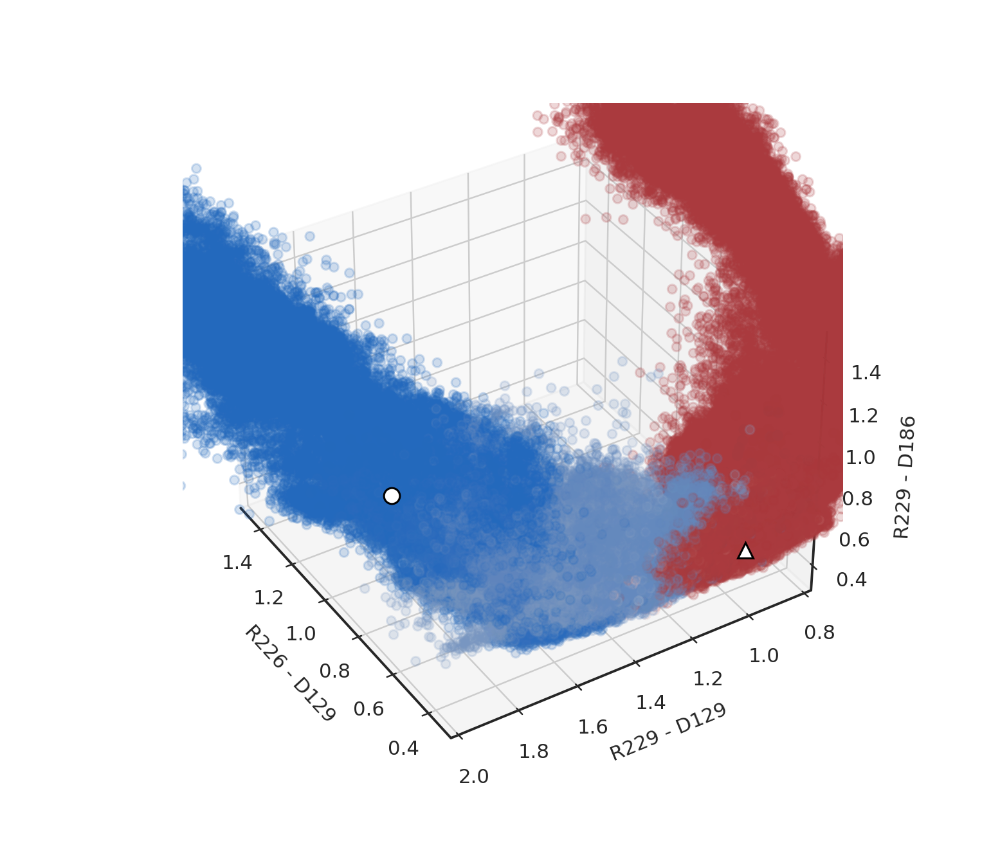

In [82]:
f = plt.figure(figsize=(7, 6))
ax = f.add_subplot(projection="3d")

q = np.concatenate(q_downup[7]).clip(min=0, max=1)
ax.scatter(
    sb_arr[::10, sb_ids[0]],
    sb_arr[::10, sb_ids[1]],
    sb_arr[::10, sb_ids[3]],
    c=q[::10],
    cmap="vlag",
    alpha=0.2,
)
ax.set_xlabel(sb_labels[sb_ids[0] - 30])
ax.set_ylabel(sb_labels[sb_ids[1] - 30])
ax.set_zlabel(sb_labels[sb_ids[3] - 30])
ax.set_xlim([0.3, 1.5])
ax.set_ylim([0.8, 2.0])
ax.set_zlim([0.3, 1.5])

ax.plot(
    feat2_models[1, sb_ids[0]],
    feat2_models[1, sb_ids[1]],
    feat2_models[1, sb_ids[3]],
    "o",
    mec="k",
    mfc="w",
    ms=8,
)
ax.plot(
    feat2_models[2, sb_ids[0]],
    feat2_models[2, sb_ids[1]],
    feat2_models[2, sb_ids[3]],
    "^",
    mec="k",
    mfc="w",
    ms=8,
)
ax.view_init(elev=15, azim=-30)

plt.show()

<IPython.core.display.Javascript object>


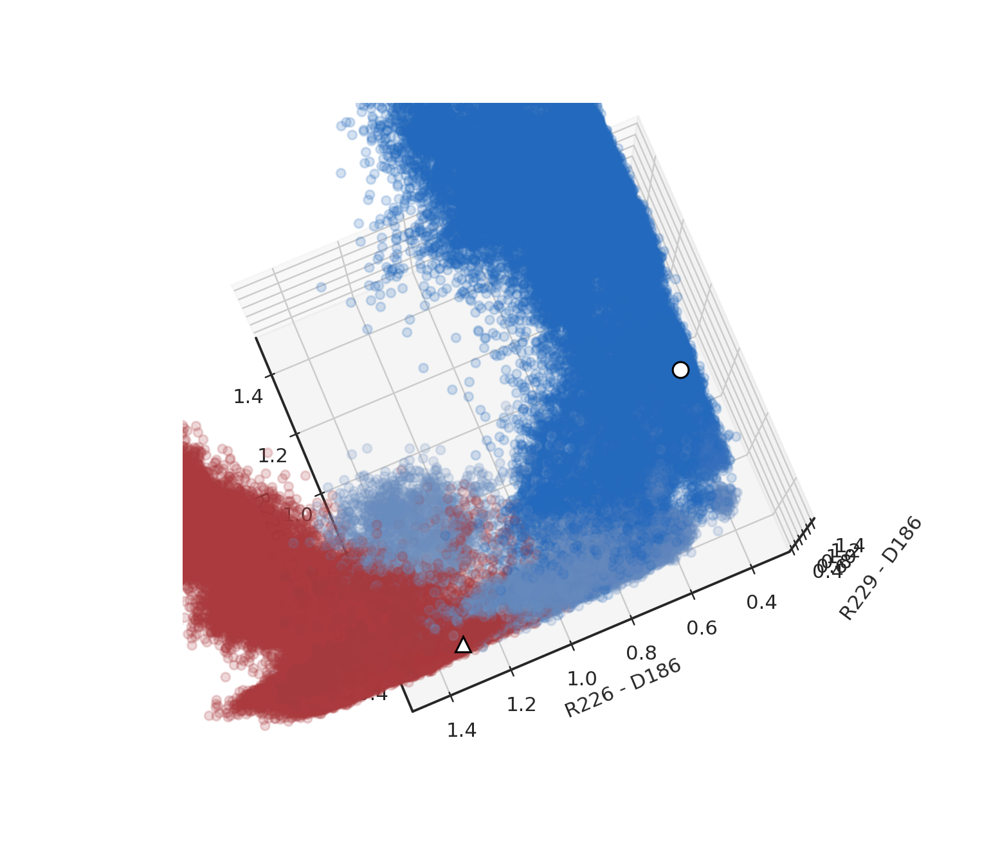

In [83]:
f = plt.figure(figsize=(7, 6))
ax = f.add_subplot(projection="3d")

q = np.concatenate(q_downup[7]).clip(min=0, max=1)
ax.scatter(
    sb_arr[::10, sb_ids[0]],
    sb_arr[::10, sb_ids[2]],
    sb_arr[::10, sb_ids[3]],
    c=q[::10],
    cmap="vlag",
    alpha=0.2,
)
ax.set_xlabel(sb_labels[sb_ids[0] - 30])
ax.set_ylabel(sb_labels[sb_ids[2] - 30])
ax.set_zlabel(sb_labels[sb_ids[3] - 30])
ax.set_xlim([0.3, 1.5])
ax.set_ylim([0.3, 1.5])
ax.set_zlim([0.3, 1.5])

ax.plot(
    feat2_models[1, sb_ids[0]],
    feat2_models[1, sb_ids[2]],
    feat2_models[1, sb_ids[3]],
    "o",
    mec="k",
    mfc="w",
    ms=8,
)
ax.plot(
    feat2_models[2, sb_ids[0]],
    feat2_models[2, sb_ids[2]],
    feat2_models[2, sb_ids[3]],
    "^",
    mec="k",
    mfc="w",
    ms=8,
)
# ax.view_init(elev=15, azim=-30)

plt.show()

In [42]:
centroids = np.loadtxt("../../models/MD-clustering-center/all.txt")

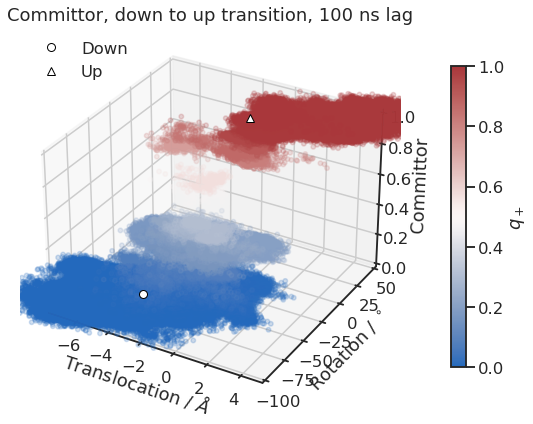

In [59]:
f = plt.figure(figsize=(9, 7))
ax = f.add_subplot(projection="3d")

s = 10
q = np.concatenate(q_downup[9]).clip(min=0, max=1)
ax.scatter(cv_arr[::s, 0], cv_arr[::s, 1], q[::s], c=q[::10], cmap="vlag", alpha=0.2)
ax.set_xlabel("Translocation / $\AA$")
ax.set_ylabel("Rotation / $^\circ$")
ax.set_zlabel("Committor")
ax.set_xlim([-7.5, 5])
ax.set_ylim([-100, 50])
ax.set_zlim([0, 1.0])
cbar = plt.colorbar(h, ax=ax, pad=0.1, fraction=0.03, label="$q_+$")
cbar.solids.set(alpha=1)
ax.set_title("Committor, down to up transition, 100 ns lag")

ax.plot(centroids[1, 0], centroids[1, 1], 0, "o", mec="k", mfc="w", ms=8)
ax.plot(centroids[2, 0], centroids[2, 1], 1, "^", mec="k", mfc="w", ms=8)
ax.legend(["Down", "Up"], loc="upper left")

plt.savefig("../../fig/committors/qf_du_dsq_lag1000.png", dpi=400)

In [ ]:
f = plt.figure(figsize=(7, 6))
ax = f.add_subplot(projection="3d")

s = 10
q = np.concatenate(q_downup[10]).clip(min=0, max=1)
ax.scatter(cv_arr[::s, 0], cv_arr[::s, 1], q[::s], c=q[::10], cmap="vlag", alpha=0.2)
ax.set_xlabel("Translocation")
ax.set_ylabel("Rotation")
ax.set_zlabel("Committor")
ax.set_xlim([-7.5, 5])
ax.set_ylim([-100, 50])
ax.set_zlim([0, 1.0])


ax.plot(centroids[1, 0], centroids[1, 1], 0, "o", mec="k", mfc="w", ms=8)
ax.plot(centroids[2, 0], centroids[2, 1], 1, "^", mec="k", mfc="w", ms=8)

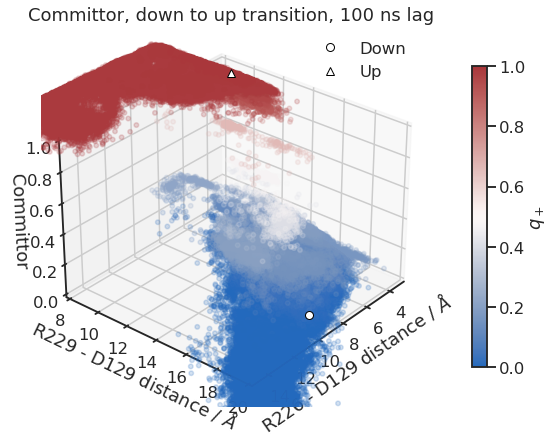

In [70]:
f = plt.figure(figsize=(9, 7))
ax = f.add_subplot(projection="3d")

s = 10
q = np.concatenate(q_downup[7]).clip(min=0, max=1)
ax.scatter(
    sb_arr[::s, sb_ids[0]] * 10,
    sb_arr[::s, sb_ids[1]] * 10,
    q[::s],
    c=q[::10],
    cmap="vlag",
    alpha=0.2,
)
ax.set_xlabel(f"{sb_labels[sb_ids[0] - 30]} distance / $\AA$")
ax.set_ylabel(f"{sb_labels[sb_ids[1] - 30]} distance / $\AA$")
ax.set_zlabel("Committor")
ax.set_xlim([3, 15])
ax.set_ylim([8, 20])
ax.set_zlim([0, 1.0])
cbar = plt.colorbar(h, ax=ax, pad=0.1, fraction=0.03, label="$q_+$")
cbar.solids.set(alpha=1)
ax.set_title("Committor, down to up transition, 100 ns lag")

ax.plot(
    feat2_models[1, sb_ids[0]] * 10,
    feat2_models[1, sb_ids[1]] * 10,
    0,
    "o",
    mec="k",
    mfc="w",
    ms=8,
)
ax.plot(
    feat2_models[2, sb_ids[0]] * 10,
    feat2_models[2, sb_ids[1]] * 10,
    1,
    "^",
    mec="k",
    mfc="w",
    ms=8,
)
ax.legend(["Down", "Up"], loc="upper right")

ax.view_init(azim=40, elev=30)

plt.savefig("../../fig/committors/qf_du_r2r3q_lag1000.png", dpi=400)

<IPython.core.display.Javascript object>


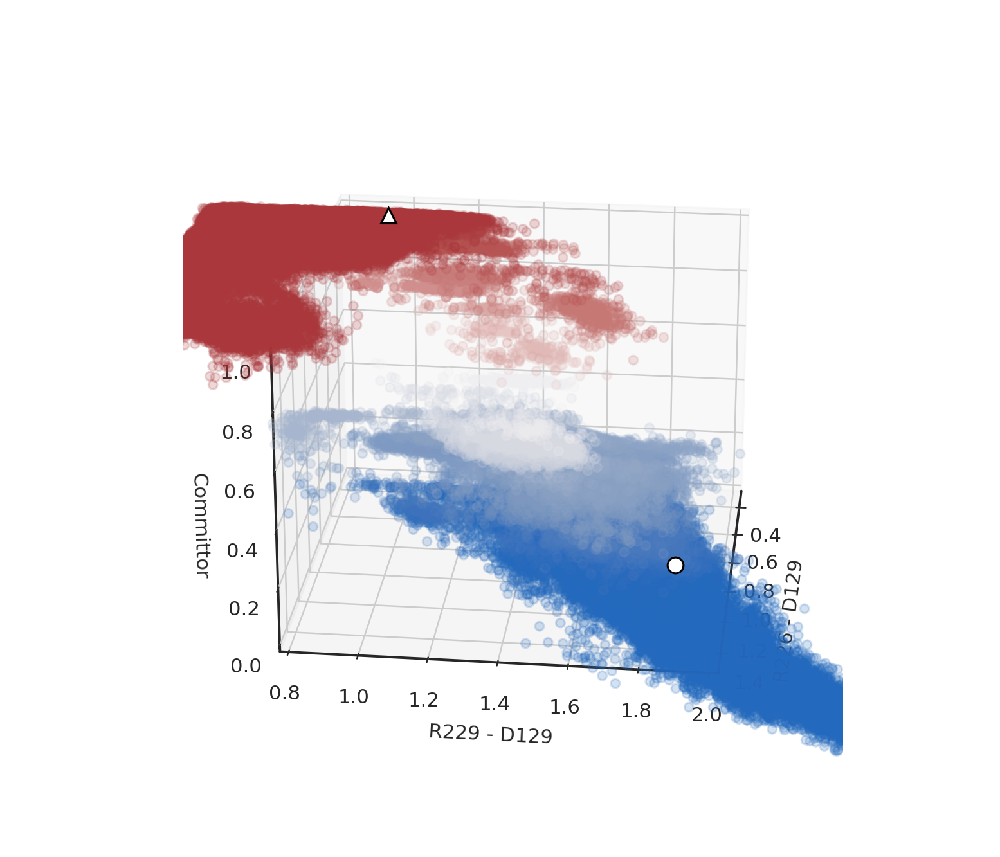

In [93]:
f = plt.figure(figsize=(7, 6))
ax = f.add_subplot(projection="3d")

s = 10
q = np.concatenate(q_downup[10]).clip(min=0, max=1)
ax.scatter(
    sb_arr[::s, sb_ids[0]],
    sb_arr[::s, sb_ids[1]],
    q[::s],
    c=q[::10],
    cmap="vlag",
    alpha=0.2,
)
ax.set_xlabel(f"{sb_labels[sb_ids[0] - 30]}")
ax.set_ylabel(f"{sb_labels[sb_ids[1] - 30]}")
ax.set_zlabel("Committor")
ax.set_xlim([0.3, 1.5])
ax.set_ylim([0.8, 2.0])
ax.set_zlim([0, 1.0])

ax.plot(
    feat2_models[1, sb_ids[0]],
    feat2_models[1, sb_ids[1]],
    0,
    "o",
    mec="k",
    mfc="w",
    ms=8,
)
ax.plot(
    feat2_models[2, sb_ids[0]],
    feat2_models[2, sb_ids[1]],
    1,
    "^",
    mec="k",
    mfc="w",
    ms=8,
)

<IPython.core.display.Javascript object>


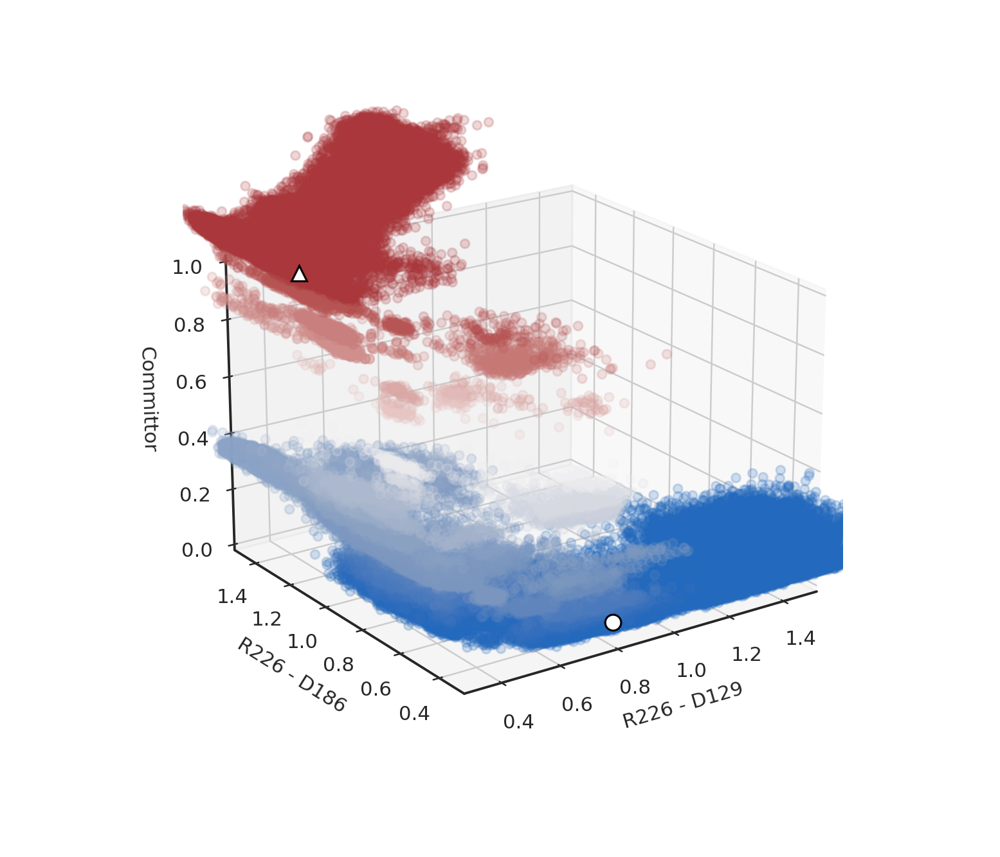

In [101]:
f = plt.figure(figsize=(7, 6))
ax = f.add_subplot(projection="3d")

s = 10
q = np.concatenate(q_downup[10]).clip(min=0, max=1)
ax.scatter(
    sb_arr[::s, sb_ids[0]],
    sb_arr[::s, sb_ids[2]],
    q[::s],
    c=q[::10],
    cmap="vlag",
    alpha=0.2,
)
ax.set_xlabel(f"{sb_labels[sb_ids[0] - 30]}")
ax.set_ylabel(f"{sb_labels[sb_ids[2] - 30]}")
ax.set_zlabel("Committor")
ax.set_xlim([0.3, 1.5])
ax.set_ylim([0.3, 1.5])
ax.set_zlim([0, 1.0])

ax.plot(
    feat2_models[1, sb_ids[0]],
    feat2_models[1, sb_ids[2]],
    0,
    "o",
    mec="k",
    mfc="w",
    ms=8,
)
ax.plot(
    feat2_models[2, sb_ids[0]],
    feat2_models[2, sb_ids[2]],
    1,
    "^",
    mec="k",
    mfc="w",
    ms=8,
)

In [95]:
kd, xe, ye = kde.kdesum2d(
    sb_arr[:, sb_ids[0]],
    sb_arr[:, sb_ids[1]],
    q,
    xmin=0.3,
    xmax=1.5,
    ymin=0.8,
    ymax=2.0,
    nx=100,
    ny=100,
)

<IPython.core.display.Javascript object>


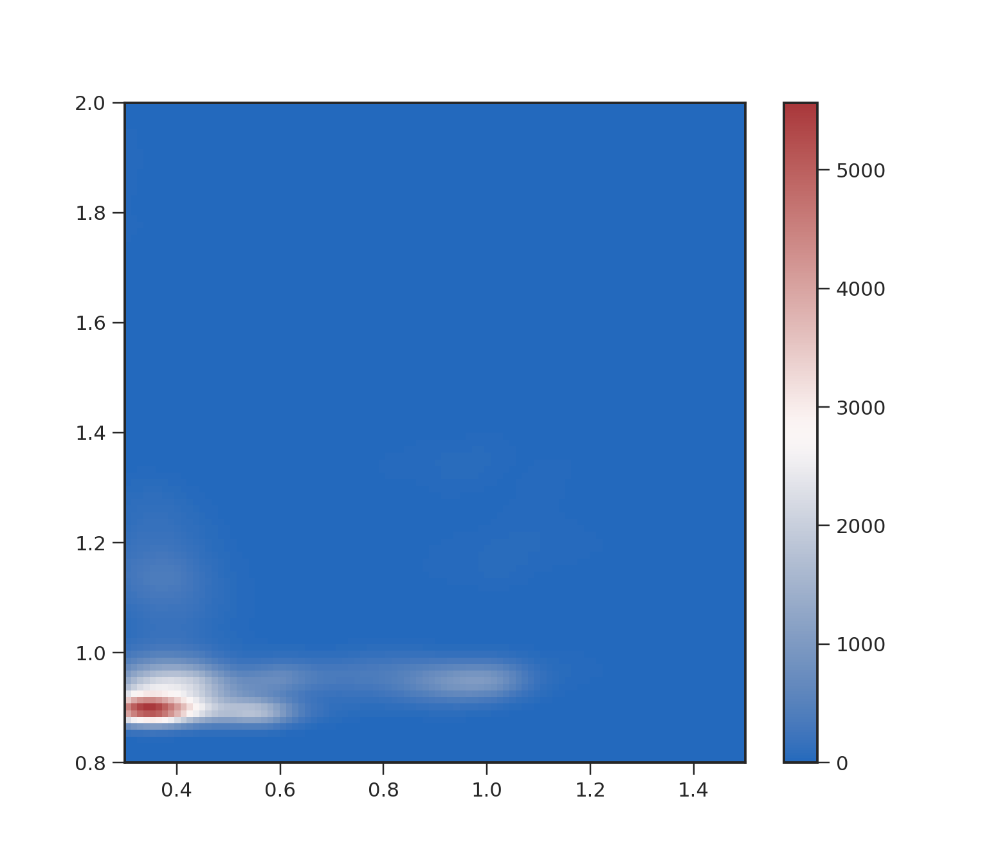

In [100]:
f = plt.figure(figsize=(7, 6))
ax = f.add_subplot(111)
h = ax.pcolormesh(xe, ye, kd, cmap="vlag")
plt.colorbar(h, ax=ax)

In [88]:
np.min((q - 0.5) ** 2)

0.0020691656874063822

In [105]:
q = np.where(q >= 0.5, q, 0)
ids = np.argsort((q - 0.5) ** 2)
for i in ids[:100]:
    print(util.anton_frame(i), cv_arr[i], q[i])

(121, 2192) [-1.842 -1.91 ] 0.6361432925995124
(204, 555) [-2.583 -0.979] 0.6361432925995124
(204, 556) [-2.437  1.265] 0.6361432925995124
(204, 557) [-2.358 -5.142] 0.6361432925995124
(204, 558) [-2.109 -0.951] 0.6361432925995124
(204, 559) [-2.43   1.777] 0.6361432925995124
(204, 560) [-2.307 -0.162] 0.6361432925995124
(208, 364) [ -3.058 -14.708] 0.6361432925995124
(204, 563) [-2.307 -1.674] 0.6361432925995124
(204, 564) [-2.531 -0.226] 0.6361432925995124
(204, 565) [-2.265 -2.121] 0.6361432925995124
(204, 554) [-2.184 -0.119] 0.6361432925995124
(204, 566) [-2.367  3.603] 0.6361432925995124
(204, 568) [-2.559  1.155] 0.6361432925995124
(204, 569) [-2.48   2.143] 0.6361432925995124
(204, 570) [-2.295  2.201] 0.6361432925995124
(204, 571) [-2.817 -0.857] 0.6361432925995124
(204, 572) [-2.688 -3.63 ] 0.6361432925995124
(204, 573) [-2.807 -3.699] 0.6361432925995124
(204, 574) [-2.513 -5.919] 0.6361432925995124
(121, 2188) [-1.723 -7.648] 0.6361432925995124
(204, 575) [-2.323 -3.755] 0.6

# Indicator basis w/ 1000 functions

**7.19.21**

## Basis set

In [15]:
# load discretized trajectories
dtrajs = np.load("../../data/raw_feat/feat5_ivac_ind1000.npy")
print(dtrajs.shape)

(3000000,)


In [16]:
dtrajs[:10]

array([410, 627, 905, 556, 747, 556, 556, 905, 556, 905], dtype=int32)

In [17]:
from scipy import sparse

In [18]:
# assemble basis using sparse matrices
nclusters = 1000

rows, cols = [], []
for i in range(nclusters):
    pts = np.argwhere(dtrajs == i)
    # indices of which frames are in the cluster i
    rows.append(pts.squeeze())
    # all assigned as 1 in the basis
    cols.append(np.repeat(i, len(pts)))
rows = np.hstack(rows)
cols = np.hstack(cols)
data = np.ones(len(rows), dtype=float)
basis = sparse.csr_matrix((data, (rows, cols)), shape=(len(cv_arr), nclusters))

In [19]:
basis.shape

(3000000, 1000)

In [21]:
# enforce boundary conditions for committor calculations
basisF_arr = basis
basisF_arr[up_ids] = 0
basisF_arr[down_ids] = 0

# remove basis functions which are completely 0 (i.e. entirely contained in A U B)
nonzero = np.where(np.sum(basisF_arr.A, axis=0) > 0)[0]
basisF_arr = basisF_arr[:, nonzero]
print(basisF_arr.shape)

(3000000, 1000)


In [23]:
traj_lens = [len(traj) for traj in cv_trajs]
traj_inds = []
subtot = 0
for length in traj_lens[:-1]:
    subtot += length
    traj_inds.append(subtot)

In [24]:
# split into lists of arrays
basisF, basisL = [], []
curr = 0
for t_len in traj_lens:
    basisF.append(basisF_arr[curr : curr + t_len])
    basisL.append(basis[curr : curr + t_len])
    curr += t_len
print(len(basisF), basisF[0].shape)
print(len(basisL), basisL[0].shape)

# guess functions
guess_down = np.zeros(len(cv_arr))
guess_down[down_ids] = 1
guessD = np.split(guess_down, traj_inds)
guess_up = np.zeros(len(cv_arr))
guess_up[up_ids] = 1
guessU = np.split(guess_up, traj_inds)

237 (10000, 1000)
237 (10000, 1000)


## weights

In [5]:
# unit is 0.1 ps, up to 500 ns
lags = [1, 2, 5, 10, 20, 50, 100, 200, 500, 1000, 2000, 5000]

In [6]:
weights = np.load("../../data/coms_feat5_ind200_anton.npy", allow_pickle=True)
weights = [*weights[:11], weights[-1]]
print(len(weights), len(weights[0]), weights[0][0].shape)

12 237 (10000,)


## Committor calculations

In [27]:
in_domain = np.split(mask, traj_inds)
q_downup, q_updown, qb_downup, qb_updown = [], [], [], []
for (lag, com) in zip(lags, weights):
    print(f"Calculating committors for lag {lag}")
    q_downup.append(
        extq.dga.forward_committor_sparse(basisF, com, in_domain, guessU, lag)
    )
    qb_downup.append(
        extq.dga.backward_committor_sparse(basisF, com, in_domain, guessD, lag)
    )
    q_updown.append(
        extq.dga.forward_committor_sparse(basisF, com, in_domain, guessD, lag)
    )
    qb_updown.append(
        extq.dga.backward_committor_sparse(basisF, com, in_domain, guessU, lag)
    )

Calculating committors for lag 1
Calculating committors for lag 2
Calculating committors for lag 5
Calculating committors for lag 10
Calculating committors for lag 20
Calculating committors for lag 50
Calculating committors for lag 100
Calculating committors for lag 200
Calculating committors for lag 500
Calculating committors for lag 1000
Calculating committors for lag 2000


/project2/roux/scguo/anaconda/envs/py37/lib/python3.7/site-packages/scipy/sparse/linalg/dsolve/linsolve.py:206: MatrixRankWarning: Matrix is exactly singular
  warn("Matrix is exactly singular", MatrixRankWarning)


Calculating committors for lag 5000


SystemError: <built-in function gssv> returned a result with an error set

In [28]:
np.save("../../data/feat5_tica_ind1000_du/q_downup", q_downup)
np.save("../../data/feat5_tica_ind1000_du/qb_downup", qb_downup)
np.save("../../data/feat5_tica_ind1000_du/q_updown", q_updown)
np.save("../../data/feat5_tica_ind1000_du/qb_updown", qb_updown)

/project2/roux/scguo/anaconda/envs/py37/lib/python3.7/site-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


In [7]:
q_downup = np.load("../../data/feat5_tica_ind1000_du/q_downup.npy", allow_pickle=True)
qb_downup = np.load("../../data/feat5_tica_ind1000_du/qb_downup.npy", allow_pickle=True)
q_updown = np.load("../../data/feat5_tica_ind1000_du/q_updown.npy", allow_pickle=True)
qb_updown = np.load("../../data/feat5_tica_ind1000_du/qb_updown.npy", allow_pickle=True)

In [8]:
print(len(q_downup))

11


### Plot

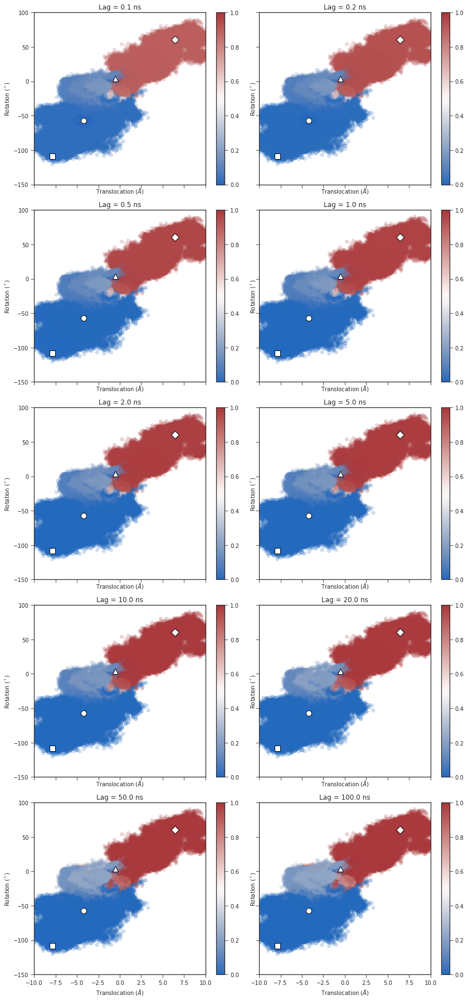

In [30]:
s = 10
f, axs = plt.subplots(5, 2, figsize=(12, 25), sharex=True, sharey=True)
for lag, q, ax in zip(lags[:10], q_downup[:10], axs.flatten()):
    q_arr = np.concatenate(q)
    h = ax.scatter(*cv_arr[::s].T, c=q_arr[::s], cmap="vlag", alpha=0.2)
    cbar = plt.colorbar(h, ax=ax)
    cbar.solids.set(alpha=1)
    ax.set_title(f"Lag = {lag * 0.1} ns")
    util.format_cvs(ax, centroids=True)
f.tight_layout()

In [9]:
# useful salt bridges for down to up transition
# R226-D129, R229-D129, R226-D186, R229-D186
sb_ids = [42, 48, 47, 53]

In [10]:
from itertools import combinations

In [11]:
feat2_models = np.load("../../data/models_centroids_feat2.npy")

/project2/roux/scguo/anaconda/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.


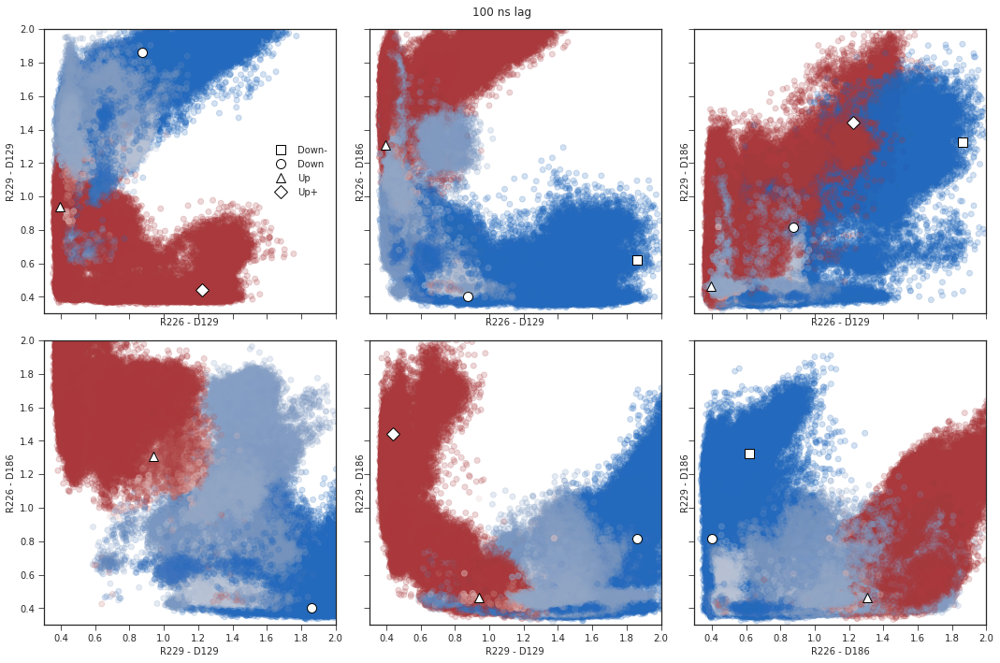

In [34]:
f, axes = plt.subplots(2, 3, figsize=(15, 10), sharex=True, sharey=True)
# 100 ns lag
q_arr = np.concatenate(q_downup[9]).clip(min=0.0, max=1.0)
for ((sb1, sb2), ax) in zip(combinations(sb_ids, 2), axes.flat):
    ax.scatter(
        sb_arr[::10, sb1], sb_arr[::10, sb2], c=q_arr[::10], cmap="vlag", alpha=0.2
    )
    ax.set(xlabel=sb_labels[sb1 - 30], ylabel=sb_labels[sb2 - 30])

axes[0][0].set(xlim=[0.3, 2.0], ylim=[0.3, 2.0])
util.plot_models(axes[0][0], feat2_models[:, 42:49:6])  # indexes 42 and 48
util.plot_models(axes[0][1], feat2_models[:, 42:48:5])  # 42 and 47
util.plot_models(axes[0][2], feat2_models[:, 42:54:11])  # 42 and 53
util.plot_models(axes[1][0], feat2_models[:, 48:46:-1])  # indexes 48 and 47
util.plot_models(axes[1][1], feat2_models[:, 48:54:5])  # 48 and 53
util.plot_models(axes[1][2], feat2_models[:, 47:54:6])  # 47 and 53
axes[0][0].legend(["Down-", "Down", "Up", "Up+"])
f.suptitle("100 ns lag")
f.tight_layout()

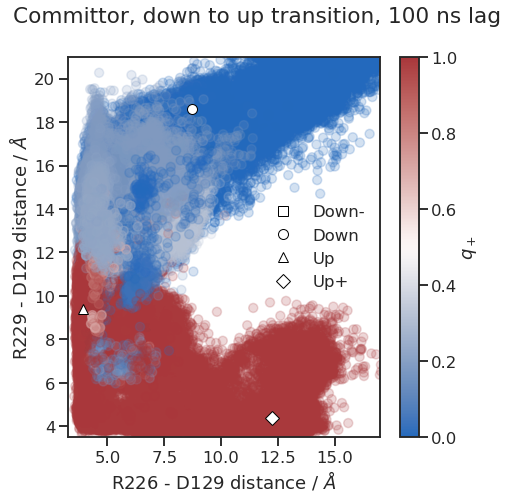

In [73]:
sns.set_context("talk")
f, ax = plt.subplots(figsize=(7, 7))
q_arr = np.concatenate(q_downup[9]).clip(min=0.0, max=1.0)
sb1, sb2 = sb_ids[:2]
h = ax.scatter(
    sb_arr[::10, sb1] * 10,  # convert to Angstroms
    sb_arr[::10, sb2] * 10,
    c=q_arr[::10],
    cmap="vlag",
    alpha=0.2,
)
ax.set(
    xlabel=f"{sb_labels[sb1 - 30]} distance / $\AA$",
    ylabel=f"{sb_labels[sb2 - 30]} distance / $\AA$",
)
ax.set(xlim=[3.25, 17], ylim=[3.5, 21])
plotting.plot_models(ax, feat2_models[:, sb1 : (sb2 + 1) : (sb2 - sb1)] * 10)
cbar = plt.colorbar(h, ax=ax, label="$q_+$")
cbar.solids.set(alpha=1)
ax.legend(["Down-", "Down", "Up", "Up+"], loc="right")
f.suptitle("Committor, down to up transition, 100 ns lag")
plt.savefig("../../fig/committors/qf_du_r2d129_r3d129_lag1000_ind1000.png", dpi=400)

In [35]:
# import pickle

In [36]:
with open("../../data/livac-feat2-anton.pkl", mode="rb") as f:
    livac = pickle.load(f)
ivac_models = livac.transform([feat2_models])[0]

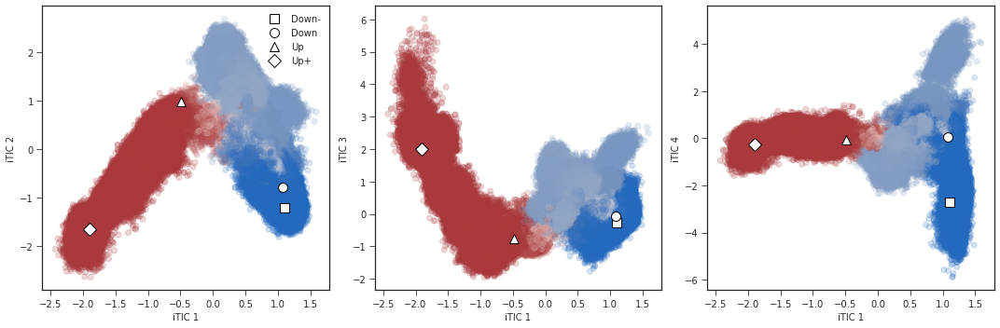

In [37]:
f, axes = plt.subplots(1, 3, figsize=(15, 5), sharex=True)
q_arr = np.concatenate(q_downup[9]).clip(min=0.0, max=1.0)
for i, ax in enumerate(axes):
    ax.scatter(
        ivac_arr[::s, 1], ivac_arr[::s, i + 2], c=q_arr[::s], cmap="vlag", alpha=0.2
    )
    ax.set(xlabel=f"iTIC 1", ylabel=f"iTIC {i + 2}")
util.plot_models(axes[0], ivac_models[:, 1:3])
util.plot_models(axes[1], ivac_models[:, 1:4:2])
util.plot_models(axes[2], ivac_models[:, 1:5:3])
axes[0].legend(["Down-", "Down", "Up", "Up+"])

f.tight_layout()

### histogrammed

In [40]:
com = np.concatenate(weights[7])
q_arr = np.concatenate(q_downup[7])
q_dens, xe, ye = np.histogram2d(
    cv_arr[:, 0], cv_arr[:, 1], bins=100, density=False, weights=q_arr * com
)
w_dens, _, _ = np.histogram2d(
    cv_arr[:, 0], cv_arr[:, 1], bins=100, density=False, weights=com
)

/project2/roux/scguo/anaconda/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in true_divide
  


Text(0.5, 1.0, 'Committor, lag = 20 ns')

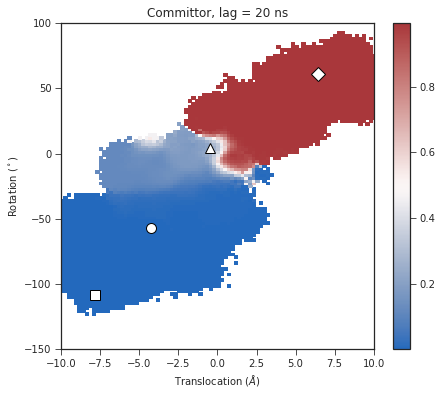

In [41]:
f, ax = plt.subplots(figsize=(7, 6))
h = ax.pcolor(xe, ye, (q_dens / w_dens).T, cmap="vlag")
plt.colorbar(
    h,
    ax=ax,
)
util.format_cvs(ax, centroids=True)
plt.title("Committor, lag = 20 ns")

/project2/roux/scguo/anaconda/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:22: RuntimeWarning: invalid value encountered in true_divide


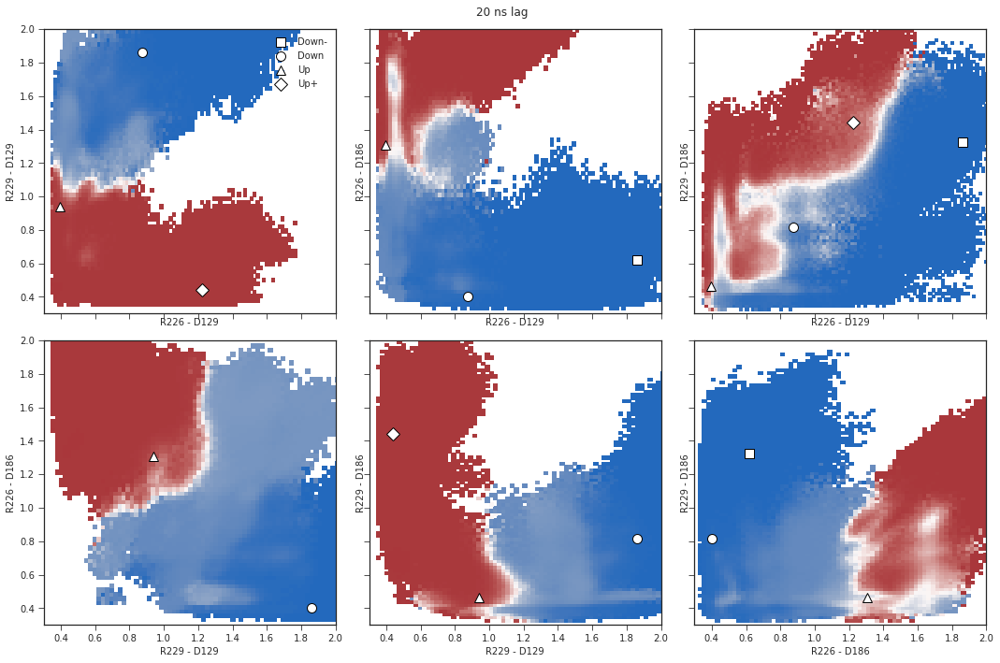

In [42]:
f, axes = plt.subplots(2, 3, figsize=(15, 10), sharex=True, sharey=True)
# 20 ns lag
q_arr = np.concatenate(q_downup[7]).clip(min=0.0, max=1.0)
for ((sb1, sb2), ax) in zip(combinations(sb_ids, 2), axes.flat):
    q_dens, xe, ye = np.histogram2d(
        sb_arr[:, sb1], sb_arr[:, sb2], bins=100, density=False, weights=q_arr * com
    )
    w_dens, _, _ = np.histogram2d(
        sb_arr[:, sb1], sb_arr[:, sb2], bins=100, density=False, weights=com
    )
    ax.pcolor(xe, ye, (q_dens / w_dens).T, cmap="vlag")
    ax.set(xlabel=sb_labels[sb1 - 30], ylabel=sb_labels[sb2 - 30])

axes[0][0].set(xlim=[0.3, 2.0], ylim=[0.3, 2.0])
util.plot_models(axes[0][0], feat2_models[:, 42:49:6])  # indexes 42 and 48
util.plot_models(axes[0][1], feat2_models[:, 42:48:5])  # 42 and 47
util.plot_models(axes[0][2], feat2_models[:, 42:54:11])  # 42 and 53
util.plot_models(axes[1][0], feat2_models[:, 48:46:-1])  # indexes 48 and 47
util.plot_models(axes[1][1], feat2_models[:, 48:54:5])  # 48 and 53
util.plot_models(axes[1][2], feat2_models[:, 47:54:6])  # 47 and 53
axes[0][0].legend(["Down-", "Down", "Up", "Up+"])
f.suptitle("20 ns lag")
f.tight_layout()

/project2/roux/scguo/anaconda/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:21: RuntimeWarning: invalid value encountered in true_divide


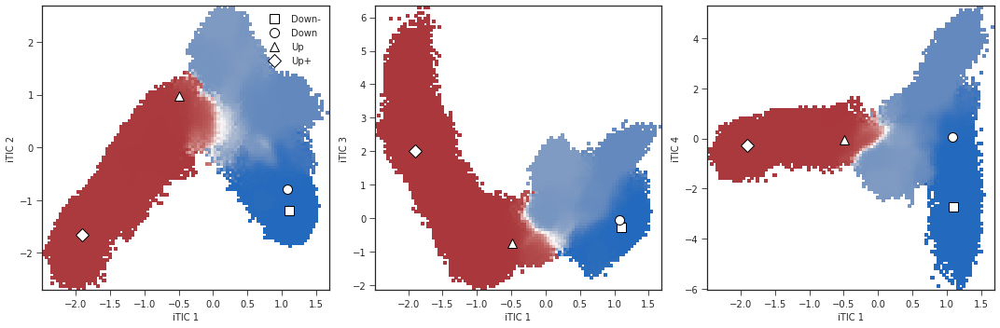

In [43]:
f, axes = plt.subplots(1, 3, figsize=(15, 5), sharex=True)
q_arr = np.concatenate(q_downup[7]).clip(min=0.0, max=1.0)
for i, ax in enumerate(axes):
    q_dens, xe, ye = np.histogram2d(
        ivac_arr[:, 1], ivac_arr[:, i + 2], bins=100, density=False, weights=q_arr * com
    )
    w_dens, _, _ = np.histogram2d(
        ivac_arr[:, 1], ivac_arr[:, i + 2], bins=100, density=False, weights=com
    )
    ax.pcolor(xe, ye, (q_dens / w_dens).T, cmap="vlag")
    ax.set(xlabel=f"iTIC 1", ylabel=f"iTIC {i + 2}")
util.plot_models(axes[0], ivac_models[:, 1:3])
util.plot_models(axes[1], ivac_models[:, 1:4:2])
util.plot_models(axes[2], ivac_models[:, 1:5:3])
axes[0].legend(["Down-", "Down", "Up", "Up+"])

f.tight_layout()

### 3d Projections

In [44]:
%matplotlib notebook

In [22]:
centroids = np.loadtxt("../../models/MD-clustering-center/all.txt")

<IPython.core.display.Javascript object>


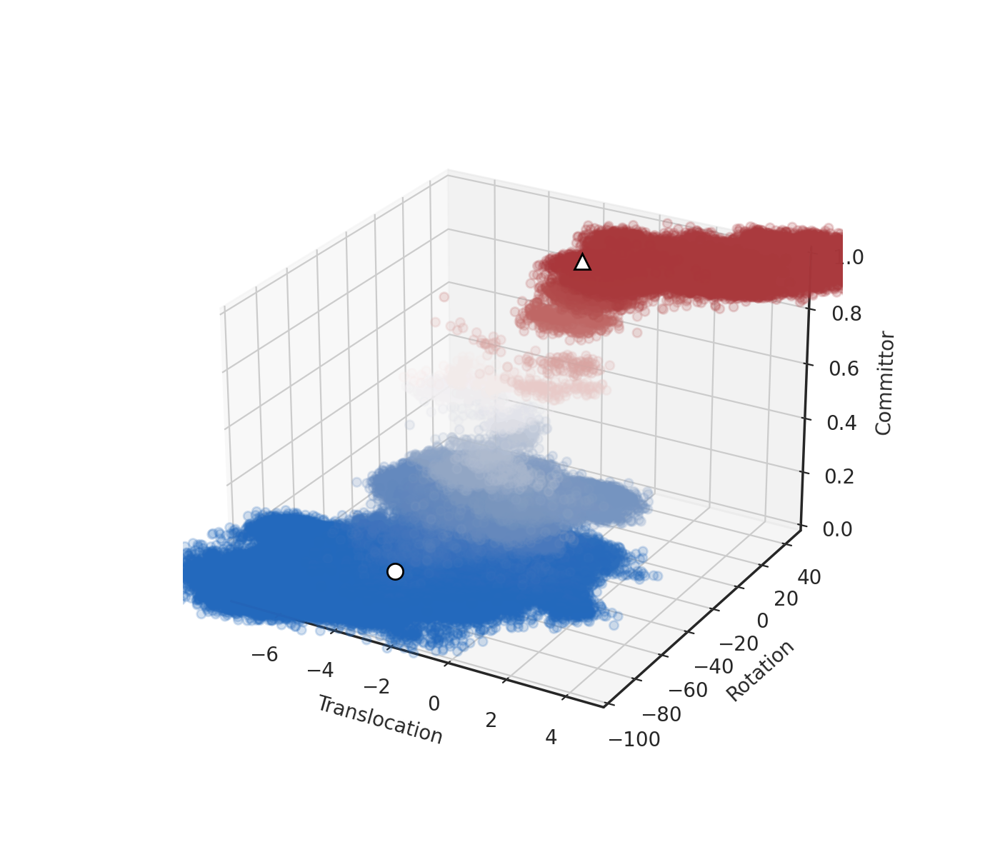

In [46]:
f = plt.figure(figsize=(7, 6))
ax = f.add_subplot(projection="3d")

s = 10
q = np.concatenate(q_downup[7]).clip(min=0, max=1)
ax.scatter(cv_arr[::s, 0], cv_arr[::s, 1], q[::s], c=q[::10], cmap="vlag", alpha=0.2)
ax.set_xlabel("Translocation")
ax.set_ylabel("Rotation")
ax.set_zlabel("Committor")
ax.set_xlim([-7.5, 5])
ax.set_ylim([-100, 50])
ax.set_zlim([0, 1.0])

ax.plot(centroids[1, 0], centroids[1, 1], 0, "o", mec="k", mfc="w", ms=8)
ax.plot(centroids[2, 0], centroids[2, 1], 1, "^", mec="k", mfc="w", ms=8)

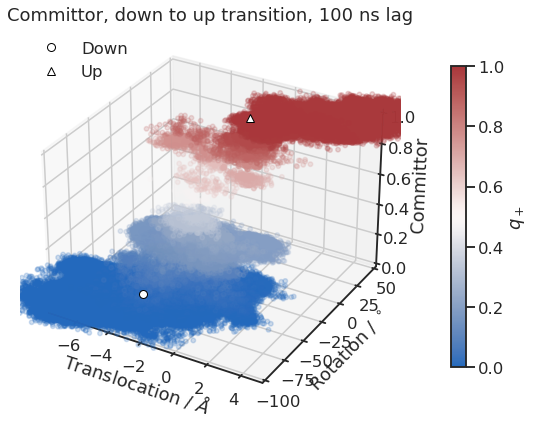

In [77]:
f = plt.figure(figsize=(9, 7))
ax = f.add_subplot(projection="3d")

s = 10
q = np.concatenate(q_downup[9]).clip(min=0, max=1)
ax.scatter(cv_arr[::s, 0], cv_arr[::s, 1], q[::s], c=q[::10], cmap="vlag", alpha=0.2)
ax.set_xlabel("Translocation / $\AA$")
ax.set_ylabel("Rotation / $^\circ$")
ax.set_zlabel("Committor")
ax.set_xlim([-7.5, 5])
ax.set_ylim([-100, 50])
ax.set_zlim([0, 1.0])
cbar = plt.colorbar(h, ax=ax, pad=0.1, fraction=0.03, label="$q_+$")
cbar.solids.set(alpha=1)
ax.set_title("Committor, down to up transition, 100 ns lag")

ax.plot(centroids[1, 0], centroids[1, 1], 0, "o", mec="k", mfc="w", ms=8)
ax.plot(centroids[2, 0], centroids[2, 1], 1, "^", mec="k", mfc="w", ms=8)
ax.legend(["Down", "Up"], loc="upper left")

plt.savefig("../../fig/committors/qf_du_dsq_lag1000_ind1000.png", dpi=400)

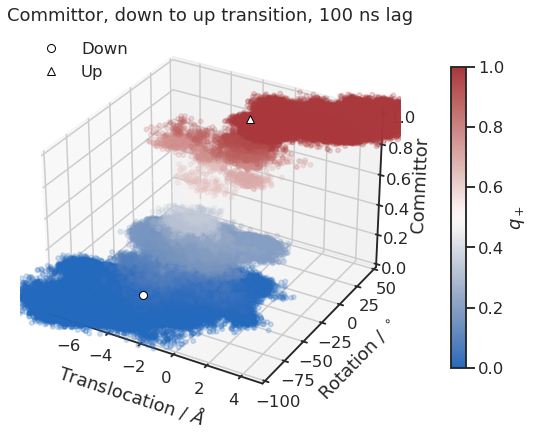

In [28]:
# 9.28.21
sns.set_context("talk")
f = plt.figure(figsize=(9, 7))
ax = f.add_subplot(projection="3d")

s = 10
q = np.concatenate(q_downup[9]).clip(min=0, max=1)
ax.scatter(cv_arr[::s, 0], cv_arr[::s, 1], q[::s], c=q[::10], cmap="vlag", alpha=0.2)
ax.set_xlabel("Translocation / $\AA$", labelpad=12)
ax.set_ylabel("Rotation / $^\circ$", labelpad=12)
ax.set_zlabel("Committor")
ax.set_xlim([-7.5, 5])
ax.set_ylim([-100, 50])
ax.set_zlim([0, 1.0])
cbar = plt.colorbar(h, ax=ax, pad=0.1, fraction=0.03, label="$q_+$")
cbar.solids.set(alpha=1)
ax.set_title("Committor, down to up transition, 100 ns lag")

ax.plot(centroids[1, 0], centroids[1, 1], 0, "o", mec="k", mfc="w", ms=8)
ax.plot(centroids[2, 0], centroids[2, 1], 1, "^", mec="k", mfc="w", ms=8)
ax.legend(["Down", "Up"], loc="upper left")
# ax.tick_params(axis='both', which='major', pad=15)

path = "../../fig/committors/qf_du_dsq_lag1000_ind1000.svg"
plt.savefig(path, transparent=True, bbox_inches="tight")

<IPython.core.display.Javascript object>


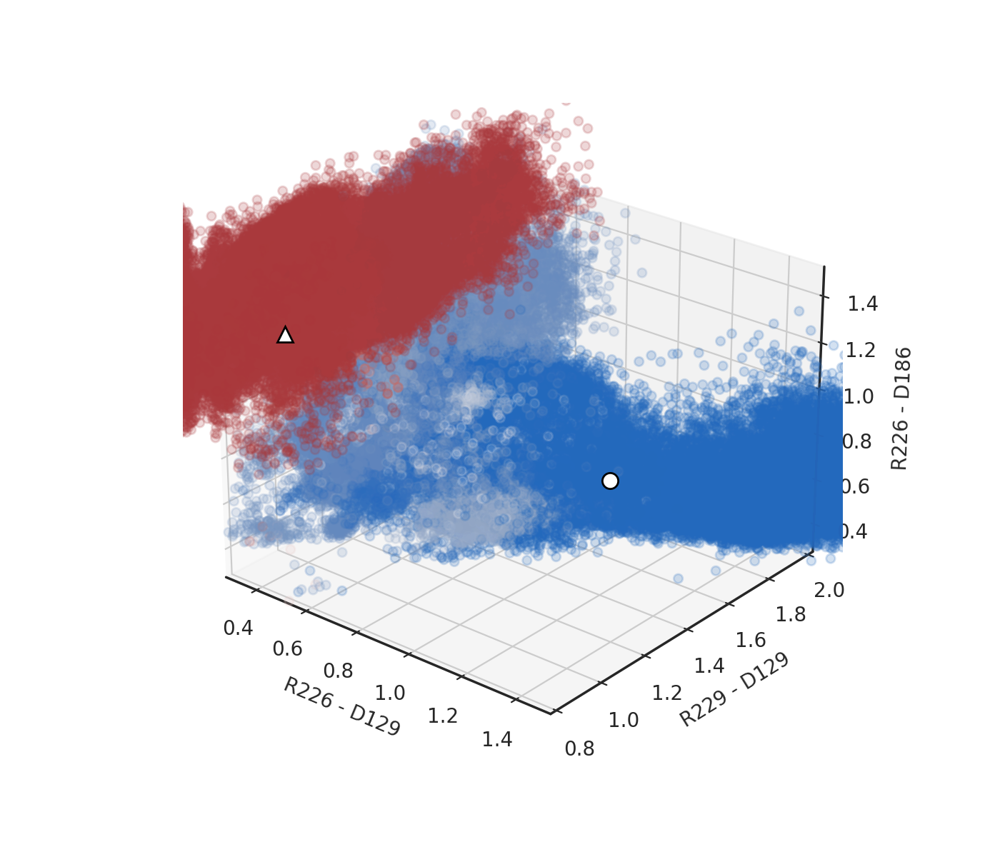

In [47]:
f = plt.figure(figsize=(7, 6))
ax = f.add_subplot(projection="3d")

q = np.concatenate(q_downup[7]).clip(min=0, max=1)
ax.scatter(
    sb_arr[::10, sb_ids[0]],
    sb_arr[::10, sb_ids[1]],
    sb_arr[::10, sb_ids[2]],
    c=q[::10],
    cmap="vlag",
    alpha=0.2,
)
ax.set_xlabel(sb_labels[sb_ids[0] - 30])
ax.set_ylabel(sb_labels[sb_ids[1] - 30])
ax.set_zlabel(sb_labels[sb_ids[2] - 30])
ax.set_xlim([0.3, 1.5])
ax.set_ylim([0.8, 2.0])
ax.set_zlim([0.3, 1.5])

ax.plot(
    feat2_models[1, sb_ids[0]],
    feat2_models[1, sb_ids[1]],
    feat2_models[1, sb_ids[2]],
    "o",
    mec="k",
    mfc="w",
    ms=8,
)
ax.plot(
    feat2_models[2, sb_ids[0]],
    feat2_models[2, sb_ids[1]],
    feat2_models[2, sb_ids[2]],
    "^",
    mec="k",
    mfc="w",
    ms=8,
)
ax.view_init(elev=15, azim=-30)

plt.show()

<IPython.core.display.Javascript object>


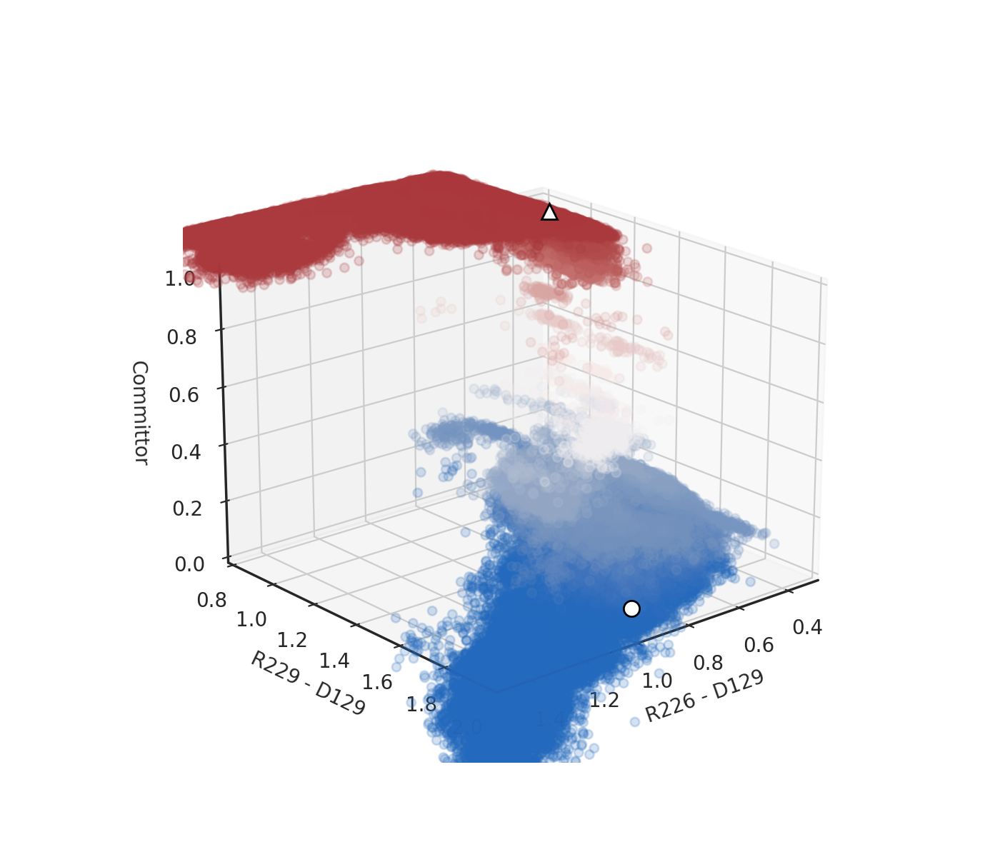

In [48]:
f = plt.figure(figsize=(7, 6))
ax = f.add_subplot(projection="3d")

s = 10
ax.scatter(
    sb_arr[::s, sb_ids[0]],
    sb_arr[::s, sb_ids[1]],
    q[::s],
    c=q[::10],
    cmap="vlag",
    alpha=0.2,
)
ax.set_xlabel(f"{sb_labels[sb_ids[0] - 30]}")
ax.set_ylabel(f"{sb_labels[sb_ids[1] - 30]}")
ax.set_zlabel("Committor")
ax.set_xlim([0.3, 1.5])
ax.set_ylim([0.8, 2.0])
ax.set_zlim([0, 1.0])
ax.view_init(elev=25, azim=-150)

ax.plot(
    feat2_models[1, sb_ids[0]],
    feat2_models[1, sb_ids[1]],
    0,
    "o",
    mec="k",
    mfc="w",
    ms=8,
)
ax.plot(
    feat2_models[2, sb_ids[0]],
    feat2_models[2, sb_ids[1]],
    1,
    "^",
    mec="k",
    mfc="w",
    ms=8,
)

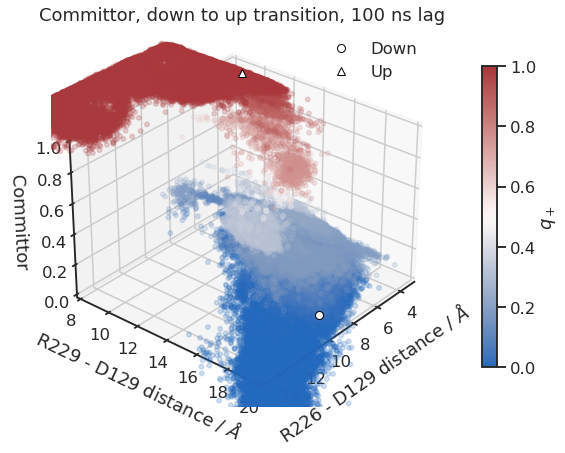

In [31]:
f = plt.figure(figsize=(9, 7))
ax = f.add_subplot(projection="3d")

s = 10
q = np.concatenate(q_downup[9]).clip(min=0, max=1)
ax.scatter(
    sb_arr[::s, sb_ids[0]] * 10,
    sb_arr[::s, sb_ids[1]] * 10,
    q[::s],
    c=q[::10],
    cmap="vlag",
    alpha=0.2,
)
ax.set_xlabel(f"{sb_labels[sb_ids[0] - 30]} distance / $\AA$", labelpad=12)
ax.set_ylabel(f"{sb_labels[sb_ids[1] - 30]} distance / $\AA$", labelpad=12)
ax.set_zlabel("Committor", labelpad=10)
ax.set_xlim([3, 15])
ax.set_ylim([8, 20])
ax.set_zlim([0, 1.0])
cbar = plt.colorbar(h, ax=ax, pad=0.1, fraction=0.03, label="$q_+$")
cbar.solids.set(alpha=1)
ax.set_title("Committor, down to up transition, 100 ns lag")

ax.plot(
    feat2_models[1, sb_ids[0]] * 10,
    feat2_models[1, sb_ids[1]] * 10,
    0,
    "o",
    mec="k",
    mfc="w",
    ms=8,
)
ax.plot(
    feat2_models[2, sb_ids[0]] * 10,
    feat2_models[2, sb_ids[1]] * 10,
    1,
    "^",
    mec="k",
    mfc="w",
    ms=8,
)
ax.legend(["Down", "Up"], loc="upper right")

ax.view_init(azim=40, elev=30)

plt.savefig(
    "../../fig/committors/qf_du_r2r3q_lag1000_ind1000.png",
    dpi=400,
    transparent=True,
    bbox_inches="tight",
)

<IPython.core.display.Javascript object>


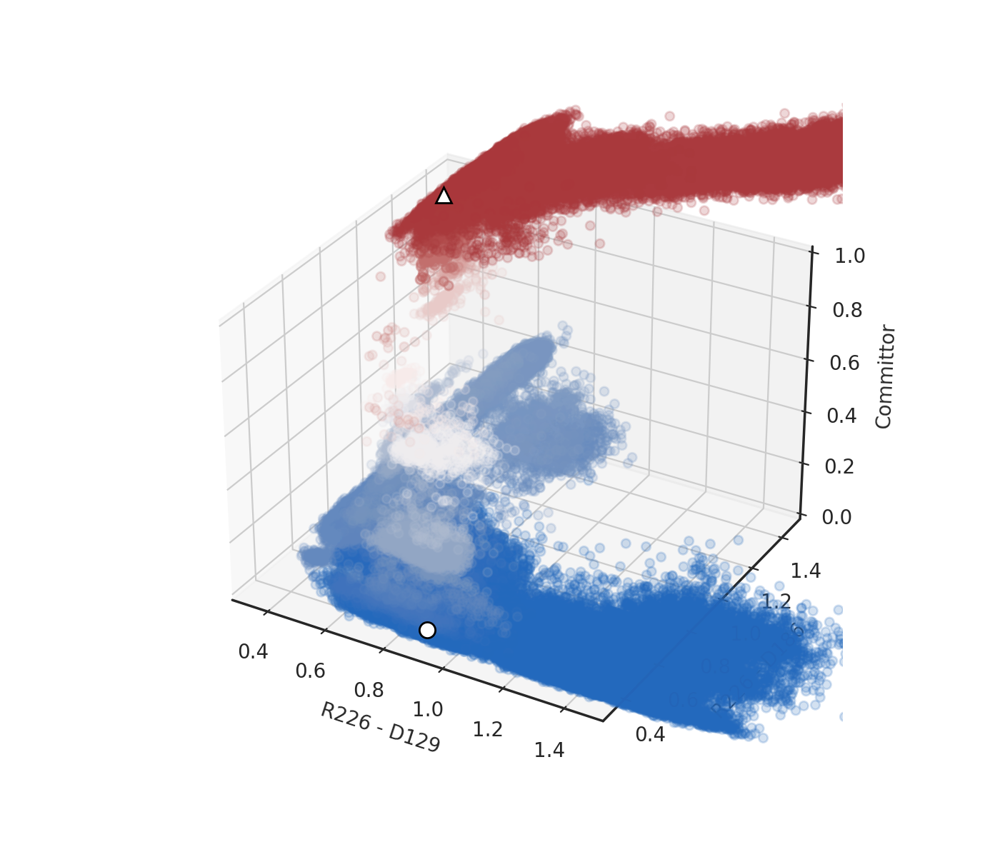

In [50]:
f = plt.figure(figsize=(7, 6))
ax = f.add_subplot(projection="3d")

s = 10
q = np.concatenate(q_downup[7]).clip(min=0, max=1)
ax.scatter(
    sb_arr[::s, sb_ids[0]],
    sb_arr[::s, sb_ids[2]],
    q[::s],
    c=q[::10],
    cmap="vlag",
    alpha=0.2,
)
ax.set_xlabel(f"{sb_labels[sb_ids[0] - 30]}")
ax.set_ylabel(f"{sb_labels[sb_ids[2] - 30]}")
ax.set_zlabel("Committor")
ax.set_xlim([0.3, 1.5])
ax.set_ylim([0.3, 1.5])
ax.set_zlim([0, 1.0])

ax.plot(
    feat2_models[1, sb_ids[0]],
    feat2_models[1, sb_ids[2]],
    0,
    "o",
    mec="k",
    mfc="w",
    ms=8,
)
ax.plot(
    feat2_models[2, sb_ids[0]],
    feat2_models[2, sb_ids[2]],
    1,
    "^",
    mec="k",
    mfc="w",
    ms=8,
)

In [74]:
# transition state
ids = np.argsort((q - 0.5) ** 2)
for i in ids[5000:10000]:
    if util.anton_frame(i)[0] != 121:
        print(f"{util.anton_frame(i)}: {q[i]:0.3f}, {cv_arr[i]}, {sb_arr[i, sb_ids]}")

(281, 9817): 0.460, [-4.813 -2.075], [0.592136   1.4439342  0.79499316 0.5342182 ]
(281, 9816): 0.460, [-4.657 -4.837], [0.44018278 1.3978854  0.9918479  0.47161955]
(204, 1073): 0.460, [ -2.741 -10.965], [0.4679167  1.1476079  0.8016196  0.42008334]
(204, 1044): 0.460, [ -2.08  -10.709], [0.45821714 1.1806885  0.83308226 0.4144804 ]
(204, 1022): 0.460, [-2.614 -9.849], [0.46156806 1.2360604  0.8467142  0.4900071 ]
(204, 1020): 0.460, [ -2.524 -12.584], [0.47302648 1.1929351  0.82674605 0.4124984 ]
(204, 7491): 0.460, [-2.727 -3.433], [0.4626511  1.0082564  1.0463146  0.47093213]
(208, 306): 0.460, [ -3.018 -14.906], [0.75303787 1.2609617  0.49646953 0.46725586]
(281, 6664): 0.460, [-3.763 -2.435], [0.5029651 1.4874935 1.0043054 0.49279  ]
(281, 6663): 0.460, [-3.947 -5.118], [0.49014902 1.4339435  1.0350025  0.46297964]
(204, 8094): 0.460, [ -4.087 -13.65 ], [0.44816184 0.9826175  0.9084015  0.4149349 ]
(204, 8096): 0.460, [ -3.889 -11.465], [0.43174765 1.070585   0.87561756 0.3952164